# Afriat

In [1]:
scan=0.1

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: ku7sppck
Name: denim-tree-111
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/ku7sppck
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-ku7sppck/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100 80GB PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2553,3311,9379
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2553,2569,1678,3436,1638,3369
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4419,10824
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 652,798,2360
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 652,633,430,854,411,830
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1165,2645
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:11<1:54:00, 11.42s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:54:00, 11.42s/it, v_num=ck_1, total_loss_train=3.71e+3, kl_local_train=44.8]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:54:00, 11.42s/it, v_num=ck_1, total_loss_train=3.71e+3, kl_local_train=44.8]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:26,  7.77s/it, v_num=ck_1, total_loss_train=3.71e+3, kl_local_train=44.8]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:26,  7.77s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:26,  7.77s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:22,  6.57s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:21<1:05:22,  6.57s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=57.9]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:21<1:05:22,  6.57s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=57.9]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:41,  6.01s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=57.9]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:41,  6.01s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=53.4]

Epoch 5/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:41,  6.01s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=53.4]

Epoch 5/600:   1%|█▎                                                                                                                                                         | 5/600 [00:32<56:30,  5.70s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=53.4]

Epoch 5/600:   1%|█▎                                                                                                                                                         | 5/600 [00:32<56:30,  5.70s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=46.5]

Epoch 6/600:   1%|█▎                                                                                                                                                         | 5/600 [00:33<56:30,  5.70s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=46.5]

Epoch 6/600:   1%|█▌                                                                                                                                                         | 6/600 [00:38<57:55,  5.85s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=46.5]

Epoch 6/600:   1%|▏                       | 6/600 [00:38<57:55,  5.85s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▏                       | 6/600 [00:38<57:55,  5.85s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▎                       | 7/600 [00:43<55:34,  5.62s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=36.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|▎                      | 7/600 [00:43<55:34,  5.62s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                      | 7/600 [00:43<55:34,  5.62s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                      | 8/600 [00:48<53:56,  5.47s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=27.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▎                      | 8/600 [00:48<53:56,  5.47s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=25.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▎                      | 8/600 [00:48<53:56,  5.47s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=25.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                      | 9/600 [00:53<52:52,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=25.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▎                      | 9/600 [00:53<52:52,  5.37s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=24.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                     | 9/600 [00:53<52:52,  5.37s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=24.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                    | 10/600 [00:58<52:05,  5.30s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=24.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▎                    | 10/600 [00:58<52:05,  5.30s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▎                    | 10/600 [00:59<52:05,  5.30s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                    | 11/600 [01:04<54:33,  5.56s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00765, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▍                    | 11/600 [01:04<54:33,  5.56s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 12/600:   2%|▍                    | 11/600 [01:04<54:33,  5.56s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:12,  5.43s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:12,  5.43s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 13/600:   2%|▍                    | 12/600 [01:10<53:12,  5.43s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:19,  5.35s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:19,  5.35s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 14/600:   2%|▍                    | 13/600 [01:15<52:19,  5.35s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 14/600:   2%|▍                    | 14/600 [01:20<51:38,  5.29s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 14/600:   2%|▍                    | 14/600 [01:20<51:38,  5.29s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 15/600:   2%|▍                    | 14/600 [01:20<51:38,  5.29s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:08,  5.25s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:08,  5.25s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 16/600:   2%|▌                    | 15/600 [01:26<51:08,  5.25s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 16/600:   3%|▌                    | 16/600 [01:31<53:39,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0509]

Epoch 16/600:   3%|▌                     | 16/600 [01:31<53:39,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▌                     | 16/600 [01:31<53:39,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▌                     | 17/600 [01:36<52:33,  5.41s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▌                     | 17/600 [01:36<52:33,  5.41s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▌                     | 17/600 [01:36<52:33,  5.41s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▋                     | 18/600 [01:42<51:45,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=62.9, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▋                     | 18/600 [01:42<51:45,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▋                     | 18/600 [01:42<51:45,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:10,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:10,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▋                     | 19/600 [01:47<51:10,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:40,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:40,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 21/600:   3%|▋                     | 20/600 [01:53<50:40,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 21/600:   4%|▊                     | 21/600 [01:58<53:12,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0706]

Epoch 21/600:   4%|▋                    | 21/600 [01:58<53:12,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 22/600:   4%|▋                    | 21/600 [01:58<53:12,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 22/600:   4%|▊                    | 22/600 [02:03<52:01,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 22/600:   4%|▊                    | 22/600 [02:03<52:01,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=84.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 23/600:   4%|▊                    | 22/600 [02:03<52:01,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=84.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 23/600:   4%|▊                    | 23/600 [02:08<51:13,  5.33s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=84.4, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 23/600:   4%|▊                    | 23/600 [02:08<51:13,  5.33s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 24/600:   4%|▊                    | 23/600 [02:08<51:13,  5.33s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 24/600:   4%|▊                    | 24/600 [02:13<50:42,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 24/600:   4%|▊                    | 24/600 [02:13<50:42,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 25/600:   4%|▊                    | 24/600 [02:13<50:42,  5.28s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 25/600:   4%|▉                    | 25/600 [02:19<50:15,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 25/600:   4%|▉                    | 25/600 [02:19<50:15,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 26/600:   4%|▉                    | 25/600 [02:20<50:15,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 26/600:   4%|▉                    | 26/600 [02:25<52:42,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=92.7, metric_mi|status_control_train=0.0529, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0637, metric_mi|mouse_train=0.0832]

Epoch 26/600:   4%|▉                      | 26/600 [02:25<52:42,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=96.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 27/600:   4%|▉                      | 26/600 [02:25<52:42,  5.51s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=96.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 27/600:   4%|█                      | 27/600 [02:30<51:34,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=96.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 27/600:   4%|█                      | 27/600 [02:30<51:34,  5.40s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=97.3, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 28/600:   4%|█                      | 27/600 [02:30<51:34,  5.40s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=97.3, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 28/600:   5%|█                      | 28/600 [02:35<50:45,  5.32s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=97.3, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 28/600:   5%|█                      | 28/600 [02:35<50:45,  5.32s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=99.1, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 29/600:   5%|█                      | 28/600 [02:35<50:45,  5.32s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=99.1, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 29/600:   5%|█                      | 29/600 [02:40<50:09,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=99.1, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 29/600:   5%|█▏                      | 29/600 [02:40<50:09,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 30/600:   5%|█▏                      | 29/600 [02:40<50:09,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 30/600:   5%|█▏                      | 30/600 [02:45<49:43,  5.23s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 30/600:   5%|█▏                      | 30/600 [02:45<49:43,  5.23s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 31/600:   5%|█▏                      | 30/600 [02:46<49:43,  5.23s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 31/600:   5%|█▏                      | 31/600 [02:51<52:09,  5.50s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.098]

Epoch 31/600:   5%|█▎                       | 31/600 [02:51<52:09,  5.50s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 32/600:   5%|█▎                       | 31/600 [02:51<52:09,  5.50s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 32/600:   5%|█▎                       | 32/600 [02:57<51:01,  5.39s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 32/600:   5%|█▎                       | 32/600 [02:57<51:01,  5.39s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 33/600:   5%|█▎                       | 32/600 [02:57<51:01,  5.39s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 33/600:   6%|█▍                       | 33/600 [03:02<50:13,  5.31s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 33/600:   6%|█▍                       | 33/600 [03:02<50:13,  5.31s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|█▍                       | 33/600 [03:02<50:13,  5.31s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|█▍                       | 34/600 [03:07<49:36,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 34/600:   6%|█▍                       | 34/600 [03:07<49:36,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 35/600:   6%|█▍                       | 34/600 [03:07<49:36,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 35/600:   6%|█▍                       | 35/600 [03:12<49:10,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 35/600:   6%|█▍                       | 35/600 [03:12<49:10,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|█▍                       | 35/600 [03:13<49:10,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|█▌                       | 36/600 [03:18<51:37,  5.49s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0792, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.107]

Epoch 36/600:   6%|█▌                       | 36/600 [03:18<51:37,  5.49s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|█▌                       | 36/600 [03:18<51:37,  5.49s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|█▌                       | 37/600 [03:23<50:32,  5.39s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|█▌                       | 37/600 [03:23<50:32,  5.39s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|█▌                       | 37/600 [03:23<50:32,  5.39s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|█▌                       | 38/600 [03:28<49:43,  5.31s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|█▌                       | 38/600 [03:28<49:43,  5.31s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|█▌                       | 38/600 [03:28<49:43,  5.31s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|█▋                       | 39/600 [03:33<49:09,  5.26s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|█▋                       | 39/600 [03:33<49:09,  5.26s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   6%|█▋                       | 39/600 [03:33<49:09,  5.26s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|█▋                       | 40/600 [03:39<48:44,  5.22s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|█▋                       | 40/600 [03:39<48:44,  5.22s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|█▋                       | 40/600 [03:40<48:44,  5.22s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|█▋                       | 41/600 [03:45<51:18,  5.51s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0961, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|█▊                        | 41/600 [03:45<51:18,  5.51s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|█▊                        | 41/600 [03:45<51:18,  5.51s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|█▊                        | 42/600 [03:50<50:16,  5.41s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 42/600:   7%|█▊                        | 42/600 [03:50<50:16,  5.41s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 43/600:   7%|█▊                        | 42/600 [03:50<50:16,  5.41s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 43/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.33s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 43/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.33s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.33s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|█▉                        | 44/600 [04:00<48:57,  5.28s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 44/600:   7%|█▉                        | 44/600 [04:00<48:57,  5.28s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 45/600:   7%|█▉                        | 44/600 [04:00<48:57,  5.28s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 45/600:   8%|█▉                        | 45/600 [04:05<48:32,  5.25s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 45/600:   8%|█▉                        | 45/600 [04:05<48:32,  5.25s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|█▉                        | 45/600 [04:06<48:32,  5.25s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|█▉                        | 46/600 [04:12<50:58,  5.52s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.115]

Epoch 46/600:   8%|█▉                        | 46/600 [04:12<50:58,  5.52s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|█▉                        | 46/600 [04:12<50:58,  5.52s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|██                        | 47/600 [04:17<49:57,  5.42s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=97.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|█▉                       | 47/600 [04:17<49:57,  5.42s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|█▉                       | 47/600 [04:17<49:57,  5.42s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|██                       | 48/600 [04:22<49:07,  5.34s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|██                       | 48/600 [04:22<49:07,  5.34s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|██                       | 48/600 [04:22<49:07,  5.34s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|██                       | 49/600 [04:27<48:32,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|██                       | 49/600 [04:27<48:32,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|██                       | 49/600 [04:27<48:32,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|██                       | 50/600 [04:32<48:03,  5.24s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=98.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|██                       | 50/600 [04:32<48:03,  5.24s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|██                       | 50/600 [04:33<48:03,  5.24s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|██▏                      | 51/600 [04:38<50:24,  5.51s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|██▏                       | 51/600 [04:38<50:24,  5.51s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 52/600:   8%|██▏                       | 51/600 [04:38<50:24,  5.51s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 52/600:   9%|██▎                       | 52/600 [04:44<49:24,  5.41s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=97.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 52/600:   9%|██▎                       | 52/600 [04:44<49:24,  5.41s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|██▎                       | 52/600 [04:44<49:24,  5.41s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|██▎                       | 53/600 [04:49<48:35,  5.33s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 53/600:   9%|██▎                       | 53/600 [04:49<48:35,  5.33s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=95.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|██▎                       | 53/600 [04:49<48:35,  5.33s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=95.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|██▎                       | 54/600 [04:54<48:06,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=95.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 54/600:   9%|██▎                       | 54/600 [04:54<48:06,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|██▎                       | 54/600 [04:54<48:06,  5.29s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|██▍                       | 55/600 [04:59<47:36,  5.24s/it, v_num=ck_1, total_loss_train=3.21e+3, kl_local_train=94.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 55/600:   9%|██▍                        | 55/600 [04:59<47:36,  5.24s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|██▍                        | 55/600 [05:00<47:36,  5.24s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|██▌                        | 56/600 [05:05<49:55,  5.51s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 56/600:   9%|██▍                       | 56/600 [05:05<49:55,  5.51s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 57/600:   9%|██▍                       | 56/600 [05:05<49:55,  5.51s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|██▍                       | 57/600 [05:10<48:49,  5.40s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=93.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|██▍                       | 57/600 [05:10<48:49,  5.40s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|██▍                       | 57/600 [05:10<48:49,  5.40s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|██▌                       | 58/600 [05:15<48:04,  5.32s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|██▌                       | 58/600 [05:15<48:04,  5.32s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|██▌                       | 58/600 [05:15<48:04,  5.32s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|██▌                       | 59/600 [05:21<47:31,  5.27s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|██▌                       | 59/600 [05:21<47:31,  5.27s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|██▌                       | 59/600 [05:21<47:31,  5.27s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|██▌                       | 60/600 [05:26<46:57,  5.22s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|██▌                       | 60/600 [05:26<46:57,  5.22s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|██▌                       | 60/600 [05:27<46:57,  5.22s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|██▋                       | 61/600 [05:32<49:19,  5.49s/it, v_num=ck_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|██▊                         | 61/600 [05:32<49:19,  5.49s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▊                         | 61/600 [05:32<49:19,  5.49s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▉                         | 62/600 [05:37<48:07,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 62/600:  10%|██▋                       | 62/600 [05:37<48:07,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▋                       | 62/600 [05:37<48:07,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▋                       | 63/600 [05:42<47:13,  5.28s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=88.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 63/600:  10%|██▋                       | 63/600 [05:42<47:13,  5.28s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=86.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 64/600:  10%|██▋                       | 63/600 [05:42<47:13,  5.28s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=86.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 64/600:  11%|██▊                       | 64/600 [05:47<46:47,  5.24s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=86.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 64/600:  11%|██▊                       | 64/600 [05:47<46:47,  5.24s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=85.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▊                       | 64/600 [05:47<46:47,  5.24s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=85.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▊                       | 65/600 [05:52<46:15,  5.19s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=85.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 65/600:  11%|██▊                       | 65/600 [05:52<46:15,  5.19s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▊                       | 65/600 [05:53<46:15,  5.19s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▊                       | 66/600 [05:58<48:52,  5.49s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 66/600:  11%|██▊                       | 66/600 [05:58<48:52,  5.49s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=83.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|██▊                       | 66/600 [05:58<48:52,  5.49s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=83.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|██▉                       | 67/600 [06:03<47:40,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=83.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|██▉                       | 67/600 [06:03<47:40,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|██▉                       | 67/600 [06:03<47:40,  5.37s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|██▉                       | 68/600 [06:09<46:48,  5.28s/it, v_num=ck_1, total_loss_train=3.19e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|██▉                       | 68/600 [06:09<46:48,  5.28s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  11%|██▉                       | 68/600 [06:09<46:48,  5.28s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|██▉                       | 69/600 [06:14<46:12,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|██▉                       | 69/600 [06:14<46:12,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|██▉                       | 69/600 [06:14<46:12,  5.22s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|███                       | 70/600 [06:19<45:44,  5.18s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|███                       | 70/600 [06:19<45:44,  5.18s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|███                       | 70/600 [06:20<45:44,  5.18s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|███                       | 71/600 [06:25<47:59,  5.44s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|██▉                      | 71/600 [06:25<47:59,  5.44s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|██▉                      | 71/600 [06:25<47:59,  5.44s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|███                      | 72/600 [06:30<46:54,  5.33s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|███                      | 72/600 [06:30<46:54,  5.33s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=80.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|███                      | 72/600 [06:30<46:54,  5.33s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=80.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|███                      | 73/600 [06:35<46:10,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=80.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|███                      | 73/600 [06:35<46:10,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|███                      | 73/600 [06:35<46:10,  5.26s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|███                      | 74/600 [06:40<45:33,  5.20s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|███▎                       | 74/600 [06:40<45:33,  5.20s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|███▎                       | 74/600 [06:40<45:33,  5.20s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|███▍                       | 75/600 [06:45<45:10,  5.16s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|███▏                     | 75/600 [06:45<45:10,  5.16s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 76/600:  12%|███▏                     | 75/600 [06:46<45:10,  5.16s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 76/600:  13%|███▏                     | 76/600 [06:51<47:26,  5.43s/it, v_num=ck_1, total_loss_train=3.18e+3, kl_local_train=78.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 76/600:  13%|███▏                     | 76/600 [06:51<47:26,  5.43s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 76/600 [06:51<47:26,  5.43s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 77/600 [06:56<46:26,  5.33s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|███▏                     | 77/600 [06:56<46:26,  5.33s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▏                     | 77/600 [06:56<46:26,  5.33s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▎                     | 78/600 [07:01<45:41,  5.25s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=77.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|███▎                     | 78/600 [07:01<45:41,  5.25s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▎                     | 78/600 [07:01<45:41,  5.25s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▎                     | 79/600 [07:06<45:10,  5.20s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|███▌                       | 79/600 [07:06<45:10,  5.20s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▌                       | 79/600 [07:06<45:10,  5.20s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▌                       | 80/600 [07:11<44:46,  5.17s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|███▎                     | 80/600 [07:11<44:46,  5.17s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 81/600:  13%|███▎                     | 80/600 [07:12<44:46,  5.17s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|███▍                     | 81/600 [07:18<47:03,  5.44s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|███▍                     | 81/600 [07:18<47:03,  5.44s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▍                     | 81/600 [07:18<47:03,  5.44s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▍                     | 82/600 [07:23<46:05,  5.34s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▍                     | 82/600 [07:23<46:05,  5.34s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▍                     | 82/600 [07:23<46:05,  5.34s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▍                     | 83/600 [07:28<45:23,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▍                     | 83/600 [07:28<45:23,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▍                     | 83/600 [07:28<45:23,  5.27s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▌                     | 84/600 [07:33<44:49,  5.21s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=74.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▌                     | 84/600 [07:33<44:49,  5.21s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 84/600 [07:33<44:49,  5.21s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 85/600 [07:38<44:23,  5.17s/it, v_num=ck_1, total_loss_train=3.17e+3, kl_local_train=73.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 85/600 [07:38<44:23,  5.17s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▌                     | 85/600 [07:39<44:23,  5.17s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▌                     | 86/600 [07:44<46:36,  5.44s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▌                     | 86/600 [07:44<46:36,  5.44s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▌                     | 86/600 [07:44<46:36,  5.44s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▌                     | 87/600 [07:49<45:38,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▌                     | 87/600 [07:49<45:38,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 88/600:  14%|███▌                     | 87/600 [07:49<45:38,  5.34s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|███▋                     | 88/600 [07:54<44:53,  5.26s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|███▋                     | 88/600 [07:54<44:53,  5.26s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▋                     | 88/600 [07:54<44:53,  5.26s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▋                     | 89/600 [07:59<44:21,  5.21s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▋                     | 89/600 [07:59<44:21,  5.21s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▋                     | 89/600 [07:59<44:21,  5.21s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▊                     | 90/600 [08:05<44:32,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▊                     | 90/600 [08:05<44:32,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|███▊                     | 90/600 [08:06<44:32,  5.24s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|███▊                     | 91/600 [08:11<46:52,  5.53s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|████                       | 91/600 [08:11<46:52,  5.53s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|████                       | 91/600 [08:11<46:52,  5.53s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|████▏                      | 92/600 [08:16<45:44,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=70.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 92/600:  15%|████▏                      | 92/600 [08:16<45:44,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 93/600:  15%|████▏                      | 92/600 [08:16<45:44,  5.40s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|████▏                      | 93/600 [08:21<45:27,  5.38s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 93/600:  16%|████▏                      | 93/600 [08:21<45:27,  5.38s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|████▏                      | 93/600 [08:21<45:27,  5.38s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|████▏                      | 94/600 [08:26<44:38,  5.29s/it, v_num=ck_1, total_loss_train=3.16e+3, kl_local_train=69.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 94/600:  16%|████▏                      | 94/600 [08:26<44:38,  5.29s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|████▏                      | 94/600 [08:26<44:38,  5.29s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|████▎                      | 95/600 [08:31<44:04,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 95/600:  16%|████▎                      | 95/600 [08:31<44:04,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|████▎                      | 95/600 [08:32<44:04,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|████▎                      | 96/600 [08:37<46:14,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 96/600:  16%|████                     | 96/600 [08:38<46:14,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████                     | 96/600 [08:38<46:14,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████                     | 97/600 [08:43<45:25,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|████                     | 97/600 [08:43<45:25,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 97/600 [08:43<45:25,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 98/600 [08:48<44:45,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|████                     | 98/600 [08:48<44:45,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████                     | 98/600 [08:48<44:45,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████▏                    | 99/600 [08:53<44:07,  5.28s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=68.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|████▏                    | 99/600 [08:53<44:07,  5.28s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 100/600:  16%|███▉                    | 99/600 [08:53<44:07,  5.28s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|███▊                   | 100/600 [08:58<43:42,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=67.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|███▊                   | 100/600 [08:58<43:42,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|███▊                   | 100/600 [08:59<43:42,  5.24s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|███▊                   | 101/600 [09:04<45:50,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|███▊                   | 101/600 [09:04<45:50,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|███▊                   | 101/600 [09:04<45:50,  5.51s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|███▉                   | 102/600 [09:10<44:58,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|███▉                   | 102/600 [09:10<44:58,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|███▉                   | 102/600 [09:10<44:58,  5.42s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|███▉                   | 103/600 [09:15<44:20,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|███▉                   | 103/600 [09:15<44:20,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|███▉                   | 103/600 [09:15<44:20,  5.35s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|███▉                   | 104/600 [09:20<43:50,  5.30s/it, v_num=ck_1, total_loss_train=3.15e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|███▉                   | 104/600 [09:20<43:50,  5.30s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 105/600:  17%|███▉                   | 104/600 [09:20<43:50,  5.30s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|████                   | 105/600 [09:25<43:20,  5.25s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|████                   | 105/600 [09:25<43:20,  5.25s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|████                   | 105/600 [09:26<43:20,  5.25s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|████                   | 106/600 [09:31<45:42,  5.55s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|███▉                  | 106/600 [09:31<45:42,  5.55s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 107/600:  18%|███▉                  | 106/600 [09:31<45:42,  5.55s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 107/600:  18%|███▉                  | 107/600 [09:37<44:49,  5.46s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 107/600:  18%|███▉                  | 107/600 [09:37<44:49,  5.46s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 108/600:  18%|███▉                  | 107/600 [09:37<44:49,  5.46s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 108/600:  18%|███▉                  | 108/600 [09:42<44:12,  5.39s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 108/600:  18%|███▉                  | 108/600 [09:42<44:12,  5.39s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 109/600:  18%|███▉                  | 108/600 [09:42<44:12,  5.39s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 109/600:  18%|███▉                  | 109/600 [09:47<43:49,  5.36s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 109/600:  18%|███▉                  | 109/600 [09:47<43:49,  5.36s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 110/600:  18%|███▉                  | 109/600 [09:47<43:49,  5.36s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 110/600:  18%|████                  | 110/600 [09:52<43:17,  5.30s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=64.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 110/600:  18%|████                  | 110/600 [09:52<43:17,  5.30s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 111/600:  18%|████                  | 110/600 [09:53<43:17,  5.30s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 111/600:  18%|████                  | 111/600 [09:58<45:31,  5.59s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.102]

Epoch 111/600:  18%|████                  | 111/600 [09:58<45:31,  5.59s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 112/600:  18%|████                  | 111/600 [09:58<45:31,  5.59s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 112/600:  19%|████                  | 112/600 [10:04<44:33,  5.48s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 112/600:  19%|████                  | 112/600 [10:04<44:33,  5.48s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|████                  | 112/600 [10:04<44:33,  5.48s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|████▏                 | 113/600 [10:09<43:35,  5.37s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|████▌                   | 113/600 [10:09<43:35,  5.37s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|████▌                   | 113/600 [10:09<43:35,  5.37s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|████▌                   | 114/600 [10:14<43:14,  5.34s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=63, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|████▏                 | 114/600 [10:14<43:14,  5.34s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|████▏                 | 114/600 [10:14<43:14,  5.34s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|████▏                 | 115/600 [10:19<42:41,  5.28s/it, v_num=ck_1, total_loss_train=3.14e+3, kl_local_train=62.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|████▏                 | 115/600 [10:19<42:41,  5.28s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|████▏                 | 115/600 [10:20<42:41,  5.28s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|████▎                 | 116/600 [10:25<44:54,  5.57s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|████▍                  | 116/600 [10:25<44:54,  5.57s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 117/600:  19%|████▍                  | 116/600 [10:25<44:54,  5.57s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 117/600:  20%|████▍                  | 117/600 [10:31<43:55,  5.46s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 117/600:  20%|████▍                  | 117/600 [10:31<43:55,  5.46s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 118/600:  20%|████▍                  | 117/600 [10:31<43:55,  5.46s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 118/600:  20%|████▌                  | 118/600 [10:36<43:04,  5.36s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 118/600:  20%|████▌                  | 118/600 [10:36<43:04,  5.36s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 119/600:  20%|████▌                  | 118/600 [10:36<43:04,  5.36s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 119/600:  20%|████▌                  | 119/600 [10:41<42:26,  5.29s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 119/600:  20%|████▉                    | 119/600 [10:41<42:26,  5.29s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 120/600:  20%|████▉                    | 119/600 [10:41<42:26,  5.29s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 120/600:  20%|█████                    | 120/600 [10:46<41:57,  5.24s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=61, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 120/600:  20%|████▌                  | 120/600 [10:46<41:57,  5.24s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 121/600:  20%|████▌                  | 120/600 [10:47<41:57,  5.24s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 121/600:  20%|████▋                  | 121/600 [10:52<44:02,  5.52s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.102]

Epoch 121/600:  20%|████▋                  | 121/600 [10:52<44:02,  5.52s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|████▋                  | 121/600 [10:52<44:02,  5.52s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|████▋                  | 122/600 [10:57<43:02,  5.40s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 122/600:  20%|████▋                  | 122/600 [10:57<43:02,  5.40s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|████▋                  | 122/600 [10:57<43:02,  5.40s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|████▋                  | 123/600 [11:02<42:19,  5.32s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 123/600:  20%|████▋                  | 123/600 [11:02<42:19,  5.32s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 124/600:  20%|████▋                  | 123/600 [11:02<42:19,  5.32s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|████▊                  | 124/600 [11:08<41:45,  5.26s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 124/600:  21%|█████▏                   | 124/600 [11:08<41:45,  5.26s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|█████▏                   | 124/600 [11:08<41:45,  5.26s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|█████▏                   | 125/600 [11:13<41:16,  5.21s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 125/600:  21%|████▊                  | 125/600 [11:13<41:16,  5.21s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|████▊                  | 125/600 [11:14<41:16,  5.21s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|████▊                  | 126/600 [11:19<43:26,  5.50s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.102]

Epoch 126/600:  21%|████▍                | 126/600 [11:19<43:26,  5.50s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|████▍                | 126/600 [11:19<43:26,  5.50s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|████▍                | 127/600 [11:24<42:28,  5.39s/it, v_num=ck_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 127/600:  21%|████▍                | 127/600 [11:24<42:28,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|████▍                | 127/600 [11:24<42:28,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|████▍                | 128/600 [11:29<41:49,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 128/600:  21%|████▍                | 128/600 [11:29<41:49,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 129/600:  21%|████▍                | 128/600 [11:29<41:49,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 129/600:  22%|████▌                | 129/600 [11:34<41:23,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 129/600:  22%|████▌                | 129/600 [11:34<41:23,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|████▌                | 129/600 [11:34<41:23,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|████▌                | 130/600 [11:39<41:01,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 130/600:  22%|████▌                | 130/600 [11:39<41:01,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|████▌                | 130/600 [11:40<41:01,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|████▌                | 131/600 [11:46<42:58,  5.50s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.101]

Epoch 131/600:  22%|████▎               | 131/600 [11:46<42:58,  5.50s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 132/600:  22%|████▎               | 131/600 [11:46<42:58,  5.50s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 132/600:  22%|████▍               | 132/600 [11:51<42:04,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 132/600:  22%|████▍               | 132/600 [11:51<42:04,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 133/600:  22%|████▍               | 132/600 [11:51<42:04,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 133/600:  22%|████▍               | 133/600 [11:56<41:22,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=58.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 133/600:  22%|████▍               | 133/600 [11:56<41:22,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 134/600:  22%|████▍               | 133/600 [11:56<41:22,  5.32s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 134/600:  22%|████▍               | 134/600 [12:01<40:53,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 134/600:  22%|████▍               | 134/600 [12:01<40:53,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 135/600:  22%|████▍               | 134/600 [12:01<40:53,  5.27s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 135/600:  22%|████▌               | 135/600 [12:06<40:27,  5.22s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 135/600:  22%|████▌               | 135/600 [12:06<40:27,  5.22s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 136/600:  22%|████▌               | 135/600 [12:07<40:27,  5.22s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 136/600:  23%|████▌               | 136/600 [12:12<42:29,  5.49s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0982]

Epoch 136/600:  23%|████▊                | 136/600 [12:12<42:29,  5.49s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 137/600:  23%|████▊                | 136/600 [12:12<42:29,  5.49s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 137/600:  23%|████▊                | 137/600 [12:17<41:34,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 137/600:  23%|████▊                | 137/600 [12:17<41:34,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 138/600:  23%|████▊                | 137/600 [12:17<41:34,  5.39s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 138/600:  23%|████▊                | 138/600 [12:23<40:50,  5.30s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 138/600:  23%|█████▎                 | 138/600 [12:23<40:50,  5.30s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 139/600:  23%|█████▎                 | 138/600 [12:23<40:50,  5.30s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 139/600:  23%|█████▎                 | 139/600 [12:28<40:17,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 139/600:  23%|████▊                | 139/600 [12:28<40:17,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 140/600:  23%|████▊                | 139/600 [12:28<40:17,  5.24s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 140/600:  23%|████▉                | 140/600 [12:33<39:54,  5.21s/it, v_num=ck_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 140/600:  23%|████▉                | 140/600 [12:33<39:54,  5.21s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 141/600:  23%|████▉                | 140/600 [12:34<39:54,  5.21s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 141/600:  24%|████▉                | 141/600 [12:39<41:53,  5.48s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0867, metric_mi|mouse_train=0.0966]

Epoch 141/600:  24%|████▋               | 141/600 [12:39<41:53,  5.48s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 142/600:  24%|████▋               | 141/600 [12:39<41:53,  5.48s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 142/600:  24%|████▋               | 142/600 [12:44<41:03,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 142/600:  24%|████▋               | 142/600 [12:44<41:03,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 143/600:  24%|████▋               | 142/600 [12:44<41:03,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 143/600:  24%|████▊               | 143/600 [12:49<40:24,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 143/600:  24%|█████▏                | 143/600 [12:49<40:24,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 144/600:  24%|█████▏                | 143/600 [12:49<40:24,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 144/600:  24%|█████▎                | 144/600 [12:54<39:50,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 144/600:  24%|████▊               | 144/600 [12:54<39:50,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 145/600:  24%|████▊               | 144/600 [12:54<39:50,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 145/600:  24%|████▊               | 145/600 [12:59<39:26,  5.20s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 145/600:  24%|████▊               | 145/600 [12:59<39:26,  5.20s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 146/600:  24%|████▊               | 145/600 [13:00<39:26,  5.20s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 146/600:  24%|████▊               | 146/600 [13:05<41:31,  5.49s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0963]

Epoch 146/600:  24%|████▊               | 146/600 [13:05<41:31,  5.49s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 147/600:  24%|████▊               | 146/600 [13:05<41:31,  5.49s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 147/600:  24%|████▉               | 147/600 [13:11<40:35,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 147/600:  24%|████▉               | 147/600 [13:11<40:35,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 148/600:  24%|████▉               | 147/600 [13:11<40:35,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 148/600:  25%|████▉               | 148/600 [13:16<40:11,  5.34s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 148/600:  25%|████▉               | 148/600 [13:16<40:11,  5.34s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 149/600:  25%|████▉               | 148/600 [13:16<40:11,  5.34s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 149/600:  25%|████▉               | 149/600 [13:21<39:36,  5.27s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 149/600:  25%|█████▍                | 149/600 [13:21<39:36,  5.27s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 150/600:  25%|█████▍                | 149/600 [13:21<39:36,  5.27s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 150/600:  25%|█████▌                | 150/600 [13:26<39:18,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 150/600:  25%|█████               | 150/600 [13:26<39:18,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 151/600:  25%|█████               | 150/600 [13:27<39:18,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 151/600:  25%|█████               | 151/600 [13:32<41:08,  5.50s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0863, metric_mi|mouse_train=0.0964]

Epoch 151/600:  25%|█████               | 151/600 [13:32<41:08,  5.50s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 152/600:  25%|█████               | 151/600 [13:32<41:08,  5.50s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 152/600:  25%|█████               | 152/600 [13:37<40:10,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 152/600:  25%|█████               | 152/600 [13:37<40:10,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 153/600:  25%|█████               | 152/600 [13:37<40:10,  5.38s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 153/600:  26%|█████               | 153/600 [13:42<39:28,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 153/600:  26%|█████               | 153/600 [13:42<39:28,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 154/600:  26%|█████               | 153/600 [13:42<39:28,  5.30s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 154/600:  26%|█████▏              | 154/600 [13:48<38:58,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 154/600:  26%|█████▏              | 154/600 [13:48<38:58,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 155/600:  26%|█████▏              | 154/600 [13:48<38:58,  5.24s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 155/600:  26%|█████▏              | 155/600 [13:53<38:38,  5.21s/it, v_num=ck_1, total_loss_train=3.11e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 155/600:  26%|█████▍               | 155/600 [13:53<38:38,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 156/600:  26%|█████▍               | 155/600 [13:54<38:38,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 156/600:  26%|█████▍               | 156/600 [13:59<40:33,  5.48s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=54.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0957]

Epoch 156/600:  26%|█████▍               | 156/600 [13:59<40:33,  5.48s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|█████▍               | 156/600 [13:59<40:33,  5.48s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|█████▍               | 157/600 [14:04<39:40,  5.37s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|█████▍               | 157/600 [14:04<39:40,  5.37s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|█████▍               | 157/600 [14:04<39:40,  5.37s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|█████▌               | 158/600 [14:09<39:03,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|█████▌               | 158/600 [14:09<39:03,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|█████▌               | 158/600 [14:09<39:03,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|█████▌               | 159/600 [14:14<38:36,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|█████▌               | 159/600 [14:14<38:36,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 160/600:  26%|█████▌               | 159/600 [14:14<38:36,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 160/600:  27%|█████▌               | 160/600 [14:19<38:13,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 160/600:  27%|█████▌               | 160/600 [14:19<38:13,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|█████▌               | 160/600 [14:20<38:13,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|█████▋               | 161/600 [14:25<40:03,  5.47s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0828, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|█████▋               | 161/600 [14:25<40:03,  5.47s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 162/600:  27%|█████▋               | 161/600 [14:25<40:03,  5.47s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 162/600:  27%|█████▋               | 162/600 [14:30<39:07,  5.36s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 162/600:  27%|█████▋               | 162/600 [14:30<39:07,  5.36s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 163/600:  27%|█████▋               | 162/600 [14:31<39:07,  5.36s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 163/600:  27%|█████▋               | 163/600 [14:36<38:33,  5.29s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 163/600:  27%|█████▋               | 163/600 [14:36<38:33,  5.29s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 164/600:  27%|█████▋               | 163/600 [14:36<38:33,  5.29s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 164/600:  27%|█████▋               | 164/600 [14:41<38:08,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 164/600:  27%|██████▎                | 164/600 [14:41<38:08,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 165/600:  27%|██████▎                | 164/600 [14:41<38:08,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 165/600:  28%|██████▎                | 165/600 [14:46<37:48,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=53, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 165/600:  28%|█████▊               | 165/600 [14:46<37:48,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 166/600:  28%|█████▊               | 165/600 [14:47<37:48,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 166/600:  28%|█████▊               | 166/600 [14:52<39:42,  5.49s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0921]

Epoch 166/600:  28%|██████▎                | 166/600 [14:52<39:42,  5.49s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 167/600:  28%|██████▎                | 166/600 [14:52<39:42,  5.49s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 167/600:  28%|██████▍                | 167/600 [14:57<38:49,  5.38s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 167/600:  28%|██████▍                | 167/600 [14:57<38:49,  5.38s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 168/600:  28%|██████▍                | 167/600 [14:57<38:49,  5.38s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 168/600:  28%|██████▍                | 168/600 [15:02<38:11,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 168/600:  28%|██████▍                | 168/600 [15:02<38:11,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 169/600:  28%|██████▍                | 168/600 [15:02<38:11,  5.30s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 169/600:  28%|██████▍                | 169/600 [15:07<37:44,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 169/600:  28%|██████▍                | 169/600 [15:07<37:44,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 170/600:  28%|██████▍                | 169/600 [15:07<37:44,  5.25s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 170/600:  28%|██████▌                | 170/600 [15:13<37:21,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 170/600:  28%|██████▌                | 170/600 [15:13<37:21,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 171/600:  28%|██████▌                | 170/600 [15:14<37:21,  5.21s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 171/600:  28%|██████▌                | 171/600 [15:19<39:14,  5.49s/it, v_num=ck_1, total_loss_train=3.1e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0846, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.09]

Epoch 171/600:  28%|█████▋              | 171/600 [15:19<39:14,  5.49s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 172/600:  28%|█████▋              | 171/600 [15:19<39:14,  5.49s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 172/600:  29%|█████▋              | 172/600 [15:24<38:22,  5.38s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 172/600:  29%|█████▋              | 172/600 [15:24<38:22,  5.38s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 173/600:  29%|█████▋              | 172/600 [15:24<38:22,  5.38s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 173/600:  29%|█████▊              | 173/600 [15:29<37:44,  5.30s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 173/600:  29%|██████▎               | 173/600 [15:29<37:44,  5.30s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 174/600:  29%|██████▎               | 173/600 [15:29<37:44,  5.30s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 174/600:  29%|██████▍               | 174/600 [15:34<37:20,  5.26s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 174/600:  29%|█████▊              | 174/600 [15:34<37:20,  5.26s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 175/600:  29%|█████▊              | 174/600 [15:34<37:20,  5.26s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 175/600:  29%|█████▊              | 175/600 [15:39<36:59,  5.22s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 175/600:  29%|█████▊              | 175/600 [15:39<36:59,  5.22s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 176/600:  29%|█████▊              | 175/600 [15:40<36:59,  5.22s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 176/600:  29%|█████▊              | 176/600 [15:45<38:50,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0885]

Epoch 176/600:  29%|██████▋                | 176/600 [15:45<38:50,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 177/600:  29%|██████▋                | 176/600 [15:45<38:50,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 177/600:  30%|██████▊                | 177/600 [15:51<38:02,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 177/600:  30%|██████▊                | 177/600 [15:51<38:02,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 178/600:  30%|██████▊                | 177/600 [15:51<38:02,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 178/600:  30%|██████▊                | 178/600 [15:56<37:26,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 178/600:  30%|██████▊                | 178/600 [15:56<37:26,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 179/600:  30%|██████▊                | 178/600 [15:56<37:26,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 179/600:  30%|██████▊                | 179/600 [16:01<36:59,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 179/600:  30%|██████▊                | 179/600 [16:01<36:59,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 180/600:  30%|██████▊                | 179/600 [16:01<36:59,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 180/600:  30%|██████▉                | 180/600 [16:06<36:38,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 180/600:  30%|██████▉                | 180/600 [16:06<36:38,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 181/600:  30%|██████▉                | 180/600 [16:07<36:38,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 181/600:  30%|██████▉                | 181/600 [16:12<38:27,  5.51s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0872]

Epoch 181/600:  30%|██████▎              | 181/600 [16:12<38:27,  5.51s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 182/600:  30%|██████▎              | 181/600 [16:12<38:27,  5.51s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 182/600:  30%|██████▎              | 182/600 [16:17<37:36,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 182/600:  30%|██████▎              | 182/600 [16:17<37:36,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 183/600:  30%|██████▎              | 182/600 [16:17<37:36,  5.40s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 183/600:  30%|██████▍              | 183/600 [16:22<37:00,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 183/600:  30%|█████▊             | 183/600 [16:22<37:00,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 184/600:  30%|█████▊             | 183/600 [16:22<37:00,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 184/600:  31%|█████▊             | 184/600 [16:28<36:31,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 184/600:  31%|█████▊             | 184/600 [16:28<36:31,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 185/600:  31%|█████▊             | 184/600 [16:28<36:31,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 185/600:  31%|█████▊             | 185/600 [16:33<36:10,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 185/600:  31%|█████▊             | 185/600 [16:33<36:10,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 186/600:  31%|█████▊             | 185/600 [16:34<36:10,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 186/600:  31%|█████▉             | 186/600 [16:39<37:56,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0997, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0866]

Epoch 186/600:  31%|█████▉             | 186/600 [16:39<37:56,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 187/600:  31%|█████▉             | 186/600 [16:39<37:56,  5.50s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 187/600:  31%|█████▉             | 187/600 [16:44<37:06,  5.39s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 187/600:  31%|█████▉             | 187/600 [16:44<37:06,  5.39s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 188/600:  31%|█████▉             | 187/600 [16:44<37:06,  5.39s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 188/600:  31%|█████▉             | 188/600 [16:49<36:31,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 188/600:  31%|█████▉             | 188/600 [16:49<36:31,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 189/600:  31%|█████▉             | 188/600 [16:49<36:31,  5.32s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 189/600:  32%|█████▉             | 189/600 [16:54<36:04,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 189/600:  32%|█████▉             | 189/600 [16:54<36:04,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 190/600:  32%|█████▉             | 189/600 [16:54<36:04,  5.27s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 190/600:  32%|██████             | 190/600 [16:59<35:43,  5.23s/it, v_num=ck_1, total_loss_train=3.09e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 190/600:  32%|██████             | 190/600 [16:59<35:43,  5.23s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 191/600:  32%|██████             | 190/600 [17:00<35:43,  5.23s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 191/600:  32%|██████             | 191/600 [17:06<37:29,  5.50s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0854]

Epoch 191/600:  32%|██████             | 191/600 [17:06<37:29,  5.50s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 192/600:  32%|██████             | 191/600 [17:06<37:29,  5.50s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 192/600:  32%|██████             | 192/600 [17:11<36:38,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 192/600:  32%|██████             | 192/600 [17:11<36:38,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 193/600:  32%|██████             | 192/600 [17:11<36:38,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 193/600:  32%|██████             | 193/600 [17:16<36:02,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 193/600:  32%|██████             | 193/600 [17:16<36:02,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 194/600:  32%|██████             | 193/600 [17:16<36:02,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 194/600:  32%|██████▏            | 194/600 [17:21<35:36,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 194/600:  32%|██████▏            | 194/600 [17:21<35:36,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 195/600:  32%|██████▏            | 194/600 [17:21<35:36,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 195/600:  32%|██████▏            | 195/600 [17:26<35:14,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 195/600:  32%|██████▏            | 195/600 [17:26<35:14,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 196/600:  32%|██████▏            | 195/600 [17:27<35:14,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 196/600:  33%|██████▏            | 196/600 [17:32<36:58,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0662, metric_mi|mouse_train=0.0838]

Epoch 196/600:  33%|██████▌             | 196/600 [17:32<36:58,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 197/600:  33%|██████▌             | 196/600 [17:32<36:58,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 197/600:  33%|██████▌             | 197/600 [17:37<36:10,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 197/600:  33%|██████▌             | 197/600 [17:37<36:10,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 198/600:  33%|██████▌             | 197/600 [17:37<36:10,  5.39s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 198/600:  33%|██████▌             | 198/600 [17:42<35:34,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 198/600:  33%|██████▌             | 198/600 [17:42<35:34,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 199/600:  33%|██████▌             | 198/600 [17:42<35:34,  5.31s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 199/600:  33%|██████▋             | 199/600 [17:48<35:08,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 199/600:  33%|██████▋             | 199/600 [17:48<35:08,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 200/600:  33%|██████▋             | 199/600 [17:48<35:08,  5.26s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 200/600:  33%|██████▋             | 200/600 [17:53<34:48,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 200/600:  33%|██████▋             | 200/600 [17:53<34:48,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 201/600:  33%|██████▋             | 200/600 [17:54<34:48,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 201/600:  34%|██████▋             | 201/600 [17:59<36:30,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.0749, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0824]

Epoch 201/600:  34%|██████▋             | 201/600 [17:59<36:30,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 202/600:  34%|██████▋             | 201/600 [17:59<36:30,  5.49s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 202/600:  34%|██████▋             | 202/600 [18:04<35:42,  5.38s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 202/600:  34%|██████▋             | 202/600 [18:04<35:42,  5.38s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 203/600:  34%|██████▋             | 202/600 [18:04<35:42,  5.38s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 203/600:  34%|██████▊             | 203/600 [18:09<35:10,  5.32s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 203/600:  34%|██████▊             | 203/600 [18:09<35:10,  5.32s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 204/600:  34%|██████▊             | 203/600 [18:09<35:10,  5.32s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 204/600:  34%|██████▊             | 204/600 [18:14<34:53,  5.29s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 204/600:  34%|██████▊             | 204/600 [18:14<34:53,  5.29s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 205/600:  34%|██████▊             | 204/600 [18:14<34:53,  5.29s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 205/600:  34%|██████▊             | 205/600 [18:20<34:31,  5.24s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 205/600:  34%|██████▊             | 205/600 [18:20<34:31,  5.24s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 206/600:  34%|██████▊             | 205/600 [18:21<34:31,  5.24s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 206/600:  34%|██████▊             | 206/600 [18:26<36:10,  5.51s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0633, metric_mi|mouse_train=0.0819]

Epoch 206/600:  34%|██████▊             | 206/600 [18:26<36:10,  5.51s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 207/600:  34%|██████▊             | 206/600 [18:26<36:10,  5.51s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 207/600:  34%|██████▉             | 207/600 [18:31<35:33,  5.43s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 207/600:  34%|██████▉             | 207/600 [18:31<35:33,  5.43s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 208/600:  34%|██████▉             | 207/600 [18:31<35:33,  5.43s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 208/600:  35%|██████▉             | 208/600 [18:36<34:51,  5.34s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 208/600:  35%|███████▋              | 208/600 [18:36<34:51,  5.34s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 209/600:  35%|███████▋              | 208/600 [18:36<34:51,  5.34s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 209/600:  35%|███████▋              | 209/600 [18:41<34:19,  5.27s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 209/600:  35%|██████▉             | 209/600 [18:41<34:19,  5.27s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 210/600:  35%|██████▉             | 209/600 [18:41<34:19,  5.27s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 210/600:  35%|███████             | 210/600 [18:46<33:57,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 210/600:  35%|███████             | 210/600 [18:46<33:57,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 211/600:  35%|███████             | 210/600 [18:47<33:57,  5.22s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 211/600:  35%|███████             | 211/600 [18:52<35:38,  5.50s/it, v_num=ck_1, total_loss_train=3.08e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0858, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0815]

Epoch 211/600:  35%|███████             | 211/600 [18:52<35:38,  5.50s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 212/600:  35%|███████             | 211/600 [18:52<35:38,  5.50s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 212/600:  35%|███████             | 212/600 [18:57<34:45,  5.38s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 212/600:  35%|███████             | 212/600 [18:57<34:45,  5.38s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 213/600:  35%|███████             | 212/600 [18:57<34:45,  5.38s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 213/600:  36%|███████             | 213/600 [19:03<34:05,  5.29s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 213/600:  36%|███████▊              | 213/600 [19:03<34:05,  5.29s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 214/600:  36%|███████▊              | 213/600 [19:03<34:05,  5.29s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 214/600:  36%|███████▊              | 214/600 [19:08<33:37,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=49, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 214/600:  36%|███████▏            | 214/600 [19:08<33:37,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 215/600:  36%|███████▏            | 214/600 [19:08<33:37,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 215/600:  36%|███████▏            | 215/600 [19:13<33:16,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 215/600:  36%|███████▏            | 215/600 [19:13<33:16,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 216/600:  36%|███████▏            | 215/600 [19:14<33:16,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 216/600:  36%|███████▏            | 216/600 [19:19<34:52,  5.45s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0845, metric_mi|zone_train=0.071, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0806]

Epoch 216/600:  36%|██████▊            | 216/600 [19:19<34:52,  5.45s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 217/600:  36%|██████▊            | 216/600 [19:19<34:52,  5.45s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 217/600:  36%|██████▊            | 217/600 [19:24<34:06,  5.34s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 217/600:  36%|██████▊            | 217/600 [19:24<34:06,  5.34s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 218/600:  36%|██████▊            | 217/600 [19:24<34:06,  5.34s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 218/600:  36%|██████▉            | 218/600 [19:29<33:31,  5.27s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 218/600:  36%|██████▉            | 218/600 [19:29<33:31,  5.27s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 219/600:  36%|██████▉            | 218/600 [19:29<33:31,  5.27s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 219/600:  36%|██████▉            | 219/600 [19:34<33:05,  5.21s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 219/600:  36%|██████▉            | 219/600 [19:34<33:05,  5.21s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 220/600:  36%|██████▉            | 219/600 [19:34<33:05,  5.21s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 220/600:  37%|██████▉            | 220/600 [19:39<32:43,  5.17s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 220/600:  37%|██████▉            | 220/600 [19:39<32:43,  5.17s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 221/600:  37%|██████▉            | 220/600 [19:40<32:43,  5.17s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 221/600:  37%|██████▉            | 221/600 [19:45<34:18,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0803]

Epoch 221/600:  37%|██████▉            | 221/600 [19:45<34:18,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 222/600:  37%|██████▉            | 221/600 [19:45<34:18,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 222/600:  37%|███████            | 222/600 [19:50<33:29,  5.32s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 222/600:  37%|███████            | 222/600 [19:50<33:29,  5.32s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 223/600:  37%|███████            | 222/600 [19:50<33:29,  5.32s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 223/600:  37%|███████            | 223/600 [19:55<32:53,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 223/600:  37%|███████            | 223/600 [19:55<32:53,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 224/600:  37%|███████            | 223/600 [19:55<32:53,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 224/600:  37%|███████            | 224/600 [20:00<32:31,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 224/600:  37%|███████            | 224/600 [20:00<32:31,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 225/600:  37%|███████            | 224/600 [20:00<32:31,  5.19s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 225/600:  38%|███████▏           | 225/600 [20:05<32:12,  5.15s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 225/600:  38%|███████▉             | 225/600 [20:05<32:12,  5.15s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 226/600:  38%|███████▉             | 225/600 [20:06<32:12,  5.15s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 226/600:  38%|███████▉             | 226/600 [20:11<33:51,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0785, metric_mi|zone_train=0.0686, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0787]

Epoch 226/600:  38%|███████▉             | 226/600 [20:11<33:51,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 227/600:  38%|███████▉             | 226/600 [20:11<33:51,  5.43s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 227/600:  38%|███████▉             | 227/600 [20:17<33:07,  5.33s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 227/600:  38%|███████▉             | 227/600 [20:17<33:07,  5.33s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 228/600:  38%|███████▉             | 227/600 [20:17<33:07,  5.33s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 228/600:  38%|███████▉             | 228/600 [20:22<32:34,  5.25s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 228/600:  38%|███████▉             | 228/600 [20:22<32:34,  5.25s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 229/600:  38%|███████▉             | 228/600 [20:22<32:34,  5.25s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 229/600:  38%|████████             | 229/600 [20:27<32:09,  5.20s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 229/600:  38%|████████             | 229/600 [20:27<32:09,  5.20s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 230/600:  38%|████████             | 229/600 [20:27<32:09,  5.20s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 230/600:  38%|████████             | 230/600 [20:32<31:49,  5.16s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 230/600:  38%|████████             | 230/600 [20:32<31:49,  5.16s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 231/600:  38%|████████             | 230/600 [20:33<31:49,  5.16s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 231/600:  38%|████████             | 231/600 [20:38<33:25,  5.44s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0768, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.078]

Epoch 231/600:  38%|███████▎           | 231/600 [20:38<33:25,  5.44s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 232/600:  38%|███████▎           | 231/600 [20:38<33:25,  5.44s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 232/600:  39%|███████▎           | 232/600 [20:43<32:51,  5.36s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 232/600:  39%|███████▎           | 232/600 [20:43<32:51,  5.36s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 233/600:  39%|███████▎           | 232/600 [20:43<32:51,  5.36s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 233/600:  39%|███████▍           | 233/600 [20:48<32:23,  5.30s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 233/600:  39%|███████▍           | 233/600 [20:48<32:23,  5.30s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 234/600:  39%|███████▍           | 233/600 [20:48<32:23,  5.30s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 234/600:  39%|███████▍           | 234/600 [20:53<32:05,  5.26s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 234/600:  39%|███████▍           | 234/600 [20:53<32:05,  5.26s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 235/600:  39%|███████▍           | 234/600 [20:53<32:05,  5.26s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 235/600:  39%|███████▍           | 235/600 [20:59<31:47,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 235/600:  39%|███████▍           | 235/600 [20:59<31:47,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 236/600:  39%|███████▍           | 235/600 [21:00<31:47,  5.23s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 236/600:  39%|███████▍           | 236/600 [21:05<33:21,  5.50s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0769, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0769]

Epoch 236/600:  39%|███████▍           | 236/600 [21:05<33:21,  5.50s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 237/600:  39%|███████▍           | 236/600 [21:05<33:21,  5.50s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 237/600:  40%|███████▌           | 237/600 [21:10<32:37,  5.39s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 237/600:  40%|███████▌           | 237/600 [21:10<32:37,  5.39s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 238/600:  40%|███████▌           | 237/600 [21:10<32:37,  5.39s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 238/600:  40%|███████▌           | 238/600 [21:15<32:05,  5.32s/it, v_num=ck_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 238/600:  40%|███████▌           | 238/600 [21:15<32:05,  5.32s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 239/600:  40%|███████▌           | 238/600 [21:15<32:05,  5.32s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 239/600:  40%|███████▌           | 239/600 [21:20<31:42,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 239/600:  40%|████████▎            | 239/600 [21:20<31:42,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 240/600:  40%|████████▎            | 239/600 [21:20<31:42,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 240/600:  40%|████████▍            | 240/600 [21:25<31:21,  5.23s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 240/600:  40%|███████▌           | 240/600 [21:25<31:21,  5.23s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 241/600:  40%|███████▌           | 240/600 [21:26<31:21,  5.23s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 241/600:  40%|███████▋           | 241/600 [21:31<32:53,  5.50s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0646, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0767]

Epoch 241/600:  40%|████████            | 241/600 [21:31<32:53,  5.50s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 242/600:  40%|████████            | 241/600 [21:31<32:53,  5.50s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 242/600:  40%|████████            | 242/600 [21:36<32:08,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 242/600:  40%|████████            | 242/600 [21:36<32:08,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 243/600:  40%|████████            | 242/600 [21:36<32:08,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 243/600:  40%|████████            | 243/600 [21:42<31:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 243/600:  40%|████████            | 243/600 [21:42<31:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 244/600:  40%|████████            | 243/600 [21:42<31:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 244/600:  41%|████████▏           | 244/600 [21:47<31:12,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 244/600:  41%|████████▏           | 244/600 [21:47<31:12,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 245/600:  41%|████████▏           | 244/600 [21:47<31:12,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 245/600:  41%|████████▏           | 245/600 [21:52<30:53,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 245/600:  41%|████████▉             | 245/600 [21:52<30:53,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 246/600:  41%|████████▉             | 245/600 [21:53<30:53,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 246/600:  41%|█████████             | 246/600 [21:58<32:23,  5.49s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.077, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0757]

Epoch 246/600:  41%|████████▌            | 246/600 [21:58<32:23,  5.49s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 247/600:  41%|████████▌            | 246/600 [21:58<32:23,  5.49s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 247/600:  41%|████████▋            | 247/600 [22:03<31:40,  5.38s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 247/600:  41%|████████▋            | 247/600 [22:03<31:40,  5.38s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 248/600:  41%|████████▋            | 247/600 [22:03<31:40,  5.38s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 248/600:  41%|████████▋            | 248/600 [22:08<31:08,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 248/600:  41%|████████▋            | 248/600 [22:08<31:08,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 249/600:  41%|████████▋            | 248/600 [22:08<31:08,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 249/600:  42%|████████▋            | 249/600 [22:13<30:47,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 249/600:  42%|████████▋            | 249/600 [22:13<30:47,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 250/600:  42%|████████▋            | 249/600 [22:13<30:47,  5.26s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 250/600:  42%|████████▊            | 250/600 [22:19<30:28,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 250/600:  42%|████████▊            | 250/600 [22:19<30:28,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 251/600:  42%|████████▊            | 250/600 [22:20<30:28,  5.22s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 251/600:  42%|████████▊            | 251/600 [22:25<32:07,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0752, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.075]

Epoch 251/600:  42%|███████▉           | 251/600 [22:25<32:07,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 252/600:  42%|███████▉           | 251/600 [22:25<32:07,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 252/600:  42%|███████▉           | 252/600 [22:30<31:27,  5.42s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 252/600:  42%|███████▉           | 252/600 [22:30<31:27,  5.42s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 253/600:  42%|███████▉           | 252/600 [22:30<31:27,  5.42s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 253/600:  42%|████████           | 253/600 [22:35<30:56,  5.35s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 253/600:  42%|████████           | 253/600 [22:35<30:56,  5.35s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 254/600:  42%|████████           | 253/600 [22:35<30:56,  5.35s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 254/600:  42%|████████           | 254/600 [22:40<30:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 254/600:  42%|████████           | 254/600 [22:40<30:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 255/600:  42%|████████           | 254/600 [22:40<30:37,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 255/600:  42%|████████           | 255/600 [22:46<30:16,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 255/600:  42%|████████           | 255/600 [22:46<30:16,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 256/600:  42%|████████           | 255/600 [22:47<30:16,  5.27s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 256/600:  43%|████████           | 256/600 [22:52<31:41,  5.53s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0735]

Epoch 256/600:  43%|████████           | 256/600 [22:52<31:41,  5.53s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 257/600:  43%|████████           | 256/600 [22:52<31:41,  5.53s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 257/600:  43%|████████▏          | 257/600 [22:57<30:57,  5.41s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 257/600:  43%|████████▏          | 257/600 [22:57<30:57,  5.41s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 258/600:  43%|████████▏          | 257/600 [22:57<30:57,  5.41s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 258/600:  43%|████████▏          | 258/600 [23:02<30:24,  5.33s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 258/600:  43%|████████▏          | 258/600 [23:02<30:24,  5.33s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 259/600:  43%|████████▏          | 258/600 [23:02<30:24,  5.33s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 259/600:  43%|████████▏          | 259/600 [23:07<30:01,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 259/600:  43%|████████▏          | 259/600 [23:07<30:01,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 260/600:  43%|████████▏          | 259/600 [23:07<30:01,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 260/600:  43%|████████▏          | 260/600 [23:12<29:42,  5.24s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 260/600:  43%|████████▏          | 260/600 [23:12<29:42,  5.24s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 261/600:  43%|████████▏          | 260/600 [23:13<29:42,  5.24s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 261/600:  44%|████████▎          | 261/600 [23:18<31:09,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0595, metric_mi|time_cat_train=0.0479, metric_mi|mouse_train=0.0724]

Epoch 261/600:  44%|█████████▏           | 261/600 [23:18<31:09,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 262/600:  44%|█████████▏           | 261/600 [23:18<31:09,  5.52s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 262/600:  44%|█████████▏           | 262/600 [23:24<30:39,  5.44s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 262/600:  44%|█████████▏           | 262/600 [23:24<30:39,  5.44s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 263/600:  44%|█████████▏           | 262/600 [23:24<30:39,  5.44s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:29<30:08,  5.37s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:29<30:08,  5.37s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 264/600:  44%|█████████▏           | 263/600 [23:29<30:08,  5.37s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 264/600:  44%|█████████▏           | 264/600 [23:34<29:45,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 264/600:  44%|█████████▏           | 264/600 [23:34<29:45,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 265/600:  44%|█████████▏           | 264/600 [23:34<29:45,  5.31s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 265/600:  44%|█████████▎           | 265/600 [23:39<29:29,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 265/600:  44%|█████████▎           | 265/600 [23:39<29:29,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 266/600:  44%|█████████▎           | 265/600 [23:40<29:29,  5.28s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 266/600:  44%|█████████▎           | 266/600 [23:46<30:59,  5.57s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.059, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0717]

Epoch 266/600:  44%|█████████▎           | 266/600 [23:46<30:59,  5.57s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 267/600:  44%|█████████▎           | 266/600 [23:46<30:59,  5.57s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 267/600:  44%|█████████▎           | 267/600 [23:51<30:19,  5.46s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 267/600:  44%|█████████▎           | 267/600 [23:51<30:19,  5.46s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 268/600:  44%|█████████▎           | 267/600 [23:51<30:19,  5.46s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 268/600:  45%|█████████▍           | 268/600 [23:56<29:49,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 268/600:  45%|█████████▍           | 268/600 [23:56<29:49,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 269/600:  45%|█████████▍           | 268/600 [23:56<29:49,  5.39s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 269/600:  45%|█████████▍           | 269/600 [24:01<29:27,  5.34s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 269/600:  45%|█████████▍           | 269/600 [24:01<29:27,  5.34s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 270/600:  45%|█████████▍           | 269/600 [24:01<29:27,  5.34s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 270/600:  45%|█████████▍           | 270/600 [24:06<29:07,  5.30s/it, v_num=ck_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 270/600:  45%|████████▌          | 270/600 [24:06<29:07,  5.30s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 271/600:  45%|████████▌          | 270/600 [24:07<29:07,  5.30s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 271/600:  45%|████████▌          | 271/600 [24:13<30:38,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0713]

Epoch 271/600:  45%|█████████▍           | 271/600 [24:13<30:38,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|█████████▍           | 271/600 [24:13<30:38,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|█████████▌           | 272/600 [24:18<30:03,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 272/600:  45%|████████▌          | 272/600 [24:18<30:03,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 273/600:  45%|████████▌          | 272/600 [24:18<30:03,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 273/600:  46%|████████▋          | 273/600 [24:23<29:39,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 273/600:  46%|████████▋          | 273/600 [24:23<29:39,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 273/600 [24:23<29:39,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 274/600 [24:29<29:19,  5.40s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 274/600:  46%|████████▋          | 274/600 [24:29<29:19,  5.40s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 274/600 [24:29<29:19,  5.40s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 275/600 [24:34<29:02,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 275/600:  46%|████████▋          | 275/600 [24:34<29:02,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|████████▋          | 275/600 [24:35<29:02,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|████████▋          | 276/600 [24:40<30:23,  5.63s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0567, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0706]

Epoch 276/600:  46%|█████████▋           | 276/600 [24:40<30:23,  5.63s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 276/600 [24:40<30:23,  5.63s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 277/600 [24:45<29:45,  5.53s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 277/600:  46%|█████████▋           | 277/600 [24:45<29:45,  5.53s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 277/600 [24:45<29:45,  5.53s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 278/600 [24:51<29:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 278/600:  46%|█████████▋           | 278/600 [24:51<29:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▋           | 278/600 [24:51<29:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▊           | 279/600 [24:56<28:55,  5.41s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 279/600:  46%|█████████▊           | 279/600 [24:56<28:55,  5.41s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 280/600:  46%|█████████▊           | 279/600 [24:56<28:55,  5.41s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 280/600:  47%|█████████▊           | 280/600 [25:01<28:37,  5.37s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 280/600:  47%|█████████▊           | 280/600 [25:01<28:37,  5.37s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|█████████▊           | 280/600 [25:02<28:37,  5.37s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|█████████▊           | 281/600 [25:07<29:57,  5.64s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0638, metric_mi|zone_train=0.0557, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.07]

Epoch 281/600:  47%|█████████▊           | 281/600 [25:07<29:57,  5.64s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 282/600:  47%|█████████▊           | 281/600 [25:07<29:57,  5.64s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 282/600:  47%|█████████▊           | 282/600 [25:13<29:11,  5.51s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 282/600:  47%|█████████▊           | 282/600 [25:13<29:11,  5.51s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 283/600:  47%|█████████▊           | 282/600 [25:13<29:11,  5.51s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 283/600:  47%|█████████▉           | 283/600 [25:18<28:39,  5.42s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 283/600:  47%|█████████▉           | 283/600 [25:18<28:39,  5.42s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 284/600:  47%|█████████▉           | 283/600 [25:18<28:39,  5.42s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 284/600:  47%|█████████▉           | 284/600 [25:23<28:12,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 284/600:  47%|█████████▉           | 284/600 [25:23<28:12,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 285/600:  47%|█████████▉           | 284/600 [25:23<28:12,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 285/600:  48%|█████████▉           | 285/600 [25:28<27:52,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 285/600:  48%|█████████▉           | 285/600 [25:28<27:52,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 286/600:  48%|█████████▉           | 285/600 [25:29<27:52,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 286/600:  48%|██████████           | 286/600 [25:35<29:15,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.069]

Epoch 286/600:  48%|█████████▌          | 286/600 [25:35<29:15,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 287/600:  48%|█████████▌          | 286/600 [25:35<29:15,  5.59s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:40<28:42,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:40<28:42,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 288/600:  48%|█████████▌          | 287/600 [25:40<28:42,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:45<28:02,  5.39s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:45<28:02,  5.39s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 289/600:  48%|█████████▌          | 288/600 [25:45<28:02,  5.39s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:50<27:30,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:50<27:30,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 290/600:  48%|█████████▋          | 289/600 [25:50<27:30,  5.31s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 290/600:  48%|█████████▋          | 290/600 [25:55<27:07,  5.25s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 290/600:  48%|█████████▋          | 290/600 [25:55<27:07,  5.25s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 291/600:  48%|█████████▋          | 290/600 [25:56<27:07,  5.25s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 291/600:  48%|█████████▋          | 291/600 [26:01<28:20,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0686]

Epoch 291/600:  48%|█████████▏         | 291/600 [26:01<28:20,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 292/600:  48%|█████████▏         | 291/600 [26:01<28:20,  5.50s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 292/600:  49%|█████████▏         | 292/600 [26:06<27:37,  5.38s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 292/600:  49%|█████████▏         | 292/600 [26:06<27:37,  5.38s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 293/600:  49%|█████████▏         | 292/600 [26:06<27:37,  5.38s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:11<27:05,  5.29s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:12<27:05,  5.29s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 294/600:  49%|█████████▎         | 293/600 [26:12<27:05,  5.29s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 294/600:  49%|█████████▎         | 294/600 [26:17<26:42,  5.24s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 294/600:  49%|█████████▎         | 294/600 [26:17<26:42,  5.24s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 295/600:  49%|█████████▎         | 294/600 [26:17<26:42,  5.24s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 295/600:  49%|█████████▎         | 295/600 [26:22<26:24,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 295/600:  49%|█████████▎         | 295/600 [26:22<26:24,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 296/600:  49%|█████████▎         | 295/600 [26:23<26:24,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 296/600:  49%|█████████▎         | 296/600 [26:28<27:43,  5.47s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0678]

Epoch 296/600:  49%|█████████▊          | 296/600 [26:28<27:43,  5.47s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 297/600:  49%|█████████▊          | 296/600 [26:28<27:43,  5.47s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 297/600:  50%|█████████▉          | 297/600 [26:33<27:04,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 297/600:  50%|█████████▉          | 297/600 [26:33<27:04,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 298/600:  50%|█████████▉          | 297/600 [26:33<27:04,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 298/600:  50%|█████████▉          | 298/600 [26:38<26:35,  5.28s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 298/600:  50%|█████████▉          | 298/600 [26:38<26:35,  5.28s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 299/600:  50%|█████████▉          | 298/600 [26:38<26:35,  5.28s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 299/600:  50%|█████████▉          | 299/600 [26:43<26:14,  5.23s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 299/600:  50%|█████████▉          | 299/600 [26:43<26:14,  5.23s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 300/600:  50%|█████████▉          | 299/600 [26:43<26:14,  5.23s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 300/600:  50%|██████████          | 300/600 [26:48<25:58,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 300/600:  50%|███████████           | 300/600 [26:48<25:58,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 301/600:  50%|███████████           | 300/600 [26:49<25:58,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 301/600:  50%|███████████           | 301/600 [26:54<27:13,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.057, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0676]

Epoch 301/600:  50%|██████████          | 301/600 [26:54<27:13,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 302/600:  50%|██████████          | 301/600 [26:54<27:13,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 302/600:  50%|██████████          | 302/600 [26:59<26:34,  5.35s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 302/600:  50%|███████████           | 302/600 [26:59<26:34,  5.35s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 303/600:  50%|███████████           | 302/600 [26:59<26:34,  5.35s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 303/600:  50%|███████████           | 303/600 [27:05<26:05,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 303/600:  50%|██████████          | 303/600 [27:05<26:05,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 304/600:  50%|██████████          | 303/600 [27:05<26:05,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 304/600:  51%|██████████▏         | 304/600 [27:10<25:46,  5.22s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 304/600:  51%|██████████▏         | 304/600 [27:10<25:46,  5.22s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 305/600:  51%|██████████▏         | 304/600 [27:10<25:46,  5.22s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 305/600:  51%|██████████▏         | 305/600 [27:15<25:29,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 305/600:  51%|███████████▏          | 305/600 [27:15<25:29,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 306/600:  51%|███████████▏          | 305/600 [27:16<25:29,  5.19s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 306/600:  51%|███████████▏          | 306/600 [27:21<26:43,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0671]

Epoch 306/600:  51%|███████████▋           | 306/600 [27:21<26:43,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 307/600:  51%|███████████▋           | 306/600 [27:21<26:43,  5.46s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 307/600:  51%|███████████▊           | 307/600 [27:26<26:04,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 307/600:  51%|██████████▋          | 307/600 [27:26<26:04,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 308/600:  51%|██████████▋          | 307/600 [27:26<26:04,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 308/600:  51%|██████████▊          | 308/600 [27:31<25:37,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 308/600:  51%|██████████▊          | 308/600 [27:31<25:37,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 309/600:  51%|██████████▊          | 308/600 [27:31<25:37,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 309/600:  52%|██████████▊          | 309/600 [27:36<25:16,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 309/600:  52%|██████████▊          | 309/600 [27:36<25:16,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 310/600:  52%|██████████▊          | 309/600 [27:36<25:16,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 310/600:  52%|██████████▊          | 310/600 [27:41<25:00,  5.17s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 310/600:  52%|███████████▉           | 310/600 [27:41<25:00,  5.17s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 311/600:  52%|███████████▉           | 310/600 [27:42<25:00,  5.17s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 311/600:  52%|███████████▉           | 311/600 [27:47<26:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.066]

Epoch 311/600:  52%|██████████▉          | 311/600 [27:47<26:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 312/600:  52%|██████████▉          | 311/600 [27:47<26:13,  5.44s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 312/600:  52%|██████████▉          | 312/600 [27:52<25:37,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 312/600:  52%|██████████▉          | 312/600 [27:52<25:37,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 313/600:  52%|██████████▉          | 312/600 [27:52<25:37,  5.34s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 313/600:  52%|██████████▉          | 313/600 [27:57<25:12,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 313/600:  52%|██████████▉          | 313/600 [27:57<25:12,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 314/600:  52%|██████████▉          | 313/600 [27:57<25:12,  5.27s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 314/600:  52%|██████████▉          | 314/600 [28:02<24:51,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 314/600:  52%|██████████▉          | 314/600 [28:02<24:51,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 315/600:  52%|██████████▉          | 314/600 [28:03<24:51,  5.21s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 315/600:  52%|███████████          | 315/600 [28:08<24:37,  5.18s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 315/600:  52%|███████████          | 315/600 [28:08<24:37,  5.18s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 316/600:  52%|███████████          | 315/600 [28:09<24:37,  5.18s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 316/600:  53%|███████████          | 316/600 [28:14<25:48,  5.45s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0655]

Epoch 316/600:  53%|██████████         | 316/600 [28:14<25:48,  5.45s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 317/600:  53%|██████████         | 316/600 [28:14<25:48,  5.45s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 317/600:  53%|██████████         | 317/600 [28:19<25:16,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 317/600:  53%|██████████         | 317/600 [28:19<25:16,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 318/600:  53%|██████████         | 317/600 [28:19<25:16,  5.36s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 318/600:  53%|██████████         | 318/600 [28:24<25:02,  5.33s/it, v_num=ck_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 318/600:  53%|██████████         | 318/600 [28:24<25:02,  5.33s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 319/600:  53%|██████████         | 318/600 [28:24<25:02,  5.33s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 319/600:  53%|██████████         | 319/600 [28:29<24:37,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 319/600:  53%|██████████         | 319/600 [28:29<24:37,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 320/600:  53%|██████████         | 319/600 [28:29<24:37,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:34<24:17,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:34<24:17,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 321/600:  53%|██████████▏        | 320/600 [28:35<24:17,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:40<25:28,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0514, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0647]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:40<25:28,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 322/600:  54%|██████████▏        | 321/600 [28:40<25:28,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:45<24:51,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:45<24:51,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 323/600:  54%|██████████▏        | 322/600 [28:45<24:51,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 323/600:  54%|██████████▏        | 323/600 [28:51<24:22,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 323/600:  54%|██████████▏        | 323/600 [28:51<24:22,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 324/600:  54%|██████████▏        | 323/600 [28:51<24:22,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 324/600:  54%|██████████▎        | 324/600 [28:56<24:02,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 324/600:  54%|██████████▎        | 324/600 [28:56<24:02,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 325/600:  54%|██████████▎        | 324/600 [28:56<24:02,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:01<23:50,  5.20s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 325/600:  54%|██████████▎        | 325/600 [29:01<23:50,  5.20s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 326/600:  54%|██████████▎        | 325/600 [29:02<23:50,  5.20s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:07<25:00,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0643]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:07<25:00,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 327/600:  54%|██████████▎        | 326/600 [29:07<25:00,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:12<24:24,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:12<24:24,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 328/600:  55%|██████████▎        | 327/600 [29:12<24:24,  5.36s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:17<23:58,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:17<23:58,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 329/600:  55%|██████████▍        | 328/600 [29:17<23:58,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:22<23:39,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 329/600:  55%|███████████▌         | 329/600 [29:22<23:39,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 330/600:  55%|███████████▌         | 329/600 [29:22<23:39,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 330/600:  55%|███████████▌         | 330/600 [29:27<23:26,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:27<23:26,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 331/600:  55%|██████████▍        | 330/600 [29:28<23:26,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:34<24:35,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0635]

Epoch 331/600:  55%|████████████▋          | 331/600 [29:34<24:35,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 332/600:  55%|████████████▋          | 331/600 [29:34<24:35,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 332/600:  55%|████████████▋          | 332/600 [29:39<24:01,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 332/600:  55%|███████████▌         | 332/600 [29:39<24:01,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 333/600:  55%|███████████▌         | 332/600 [29:39<24:01,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 333/600:  56%|███████████▋         | 333/600 [29:44<23:35,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 333/600:  56%|███████████▋         | 333/600 [29:44<23:35,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 334/600:  56%|███████████▋         | 333/600 [29:44<23:35,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 334/600:  56%|███████████▋         | 334/600 [29:49<23:15,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 334/600:  56%|███████████▋         | 334/600 [29:49<23:15,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 335/600:  56%|███████████▋         | 334/600 [29:49<23:15,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 335/600:  56%|███████████▋         | 335/600 [29:54<23:00,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 335/600:  56%|███████████▋         | 335/600 [29:54<23:00,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 336/600:  56%|███████████▋         | 335/600 [29:55<23:00,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 336/600:  56%|███████████▊         | 336/600 [30:00<24:07,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.063]

Epoch 336/600:  56%|███████████▊         | 336/600 [30:00<24:07,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|███████████▊         | 336/600 [30:00<24:07,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|███████████▊         | 337/600 [30:05<23:33,  5.37s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=44, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:05<23:33,  5.37s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 337/600 [30:05<23:33,  5.37s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:10<23:09,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:10<23:09,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 338/600 [30:10<23:09,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:16<22:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:16<22:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 340/600:  56%|██████████▋        | 339/600 [30:16<22:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:21<22:37,  5.22s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:21<22:37,  5.22s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|██████████▊        | 340/600 [30:22<22:37,  5.22s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:27<23:44,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0468, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0625]

Epoch 341/600:  57%|███████████▎        | 341/600 [30:27<23:44,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 342/600:  57%|███████████▎        | 341/600 [30:27<23:44,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 342/600:  57%|███████████▍        | 342/600 [30:32<23:12,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 342/600:  57%|███████████▍        | 342/600 [30:32<23:12,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 343/600:  57%|███████████▍        | 342/600 [30:32<23:12,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 343/600:  57%|███████████▍        | 343/600 [30:37<22:47,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 343/600:  57%|███████████▍        | 343/600 [30:37<22:47,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 344/600:  57%|███████████▍        | 343/600 [30:37<22:47,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 344/600:  57%|███████████▍        | 344/600 [30:42<22:28,  5.27s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 344/600:  57%|███████████▍        | 344/600 [30:42<22:28,  5.27s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 345/600:  57%|███████████▍        | 344/600 [30:42<22:28,  5.27s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 345/600:  57%|███████████▌        | 345/600 [30:47<22:12,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 345/600:  57%|███████████▌        | 345/600 [30:47<22:12,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 346/600:  57%|███████████▌        | 345/600 [30:48<22:12,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 346/600:  58%|███████████▌        | 346/600 [30:54<23:21,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0451, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.062]

Epoch 346/600:  58%|███████████▌        | 346/600 [30:54<23:21,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 347/600:  58%|███████████▌        | 346/600 [30:54<23:21,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 347/600:  58%|███████████▌        | 347/600 [30:59<22:49,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 347/600:  58%|███████████▌        | 347/600 [30:59<22:49,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 348/600:  58%|███████████▌        | 347/600 [30:59<22:49,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 348/600:  58%|███████████▌        | 348/600 [31:04<22:25,  5.34s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 348/600:  58%|███████████▌        | 348/600 [31:04<22:25,  5.34s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 349/600:  58%|███████████▌        | 348/600 [31:04<22:25,  5.34s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 349/600:  58%|███████████▋        | 349/600 [31:09<22:08,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 349/600:  58%|███████████▋        | 349/600 [31:09<22:08,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 350/600:  58%|███████████▋        | 349/600 [31:09<22:08,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 350/600:  58%|███████████▋        | 350/600 [31:14<21:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 350/600:  58%|███████████▋        | 350/600 [31:14<21:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 351/600:  58%|███████████▋        | 350/600 [31:15<21:51,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 351/600:  58%|███████████▋        | 351/600 [31:20<22:52,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0617]

Epoch 351/600:  58%|███████████        | 351/600 [31:20<22:52,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 352/600:  58%|███████████        | 351/600 [31:20<22:52,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:26<22:17,  5.39s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:26<22:17,  5.39s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 353/600:  59%|███████████▏       | 352/600 [31:26<22:17,  5.39s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:31<21:55,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:31<21:55,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 354/600:  59%|███████████▏       | 353/600 [31:31<21:55,  5.32s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:36<21:37,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:36<21:37,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 355/600:  59%|███████████▏       | 354/600 [31:36<21:37,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:41<21:24,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:41<21:24,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 356/600:  59%|███████████▏       | 355/600 [31:42<21:24,  5.24s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:47<22:25,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0429, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0611]

Epoch 356/600:  59%|█████████████         | 356/600 [31:47<22:25,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 357/600:  59%|█████████████         | 356/600 [31:47<22:25,  5.52s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 357/600:  60%|█████████████         | 357/600 [31:52<21:51,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 357/600:  60%|█████████████         | 357/600 [31:52<21:51,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 358/600:  60%|█████████████         | 357/600 [31:52<21:51,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 358/600:  60%|█████████████▏        | 358/600 [31:57<21:26,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 358/600:  60%|█████████████▏        | 358/600 [31:57<21:26,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 359/600:  60%|█████████████▏        | 358/600 [31:57<21:26,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 359/600:  60%|█████████████▏        | 359/600 [32:03<21:07,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 359/600:  60%|█████████████▏        | 359/600 [32:03<21:07,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 360/600:  60%|█████████████▏        | 359/600 [32:03<21:07,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 360/600:  60%|█████████████▏        | 360/600 [32:08<20:54,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 360/600:  60%|█████████████▏        | 360/600 [32:08<20:54,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 361/600:  60%|█████████████▏        | 360/600 [32:09<20:54,  5.23s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 361/600:  60%|█████████████▏        | 361/600 [32:14<21:55,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.061]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:14<21:55,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 362/600:  60%|███████████▍       | 361/600 [32:14<21:55,  5.50s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:19<21:25,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:19<21:25,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 363/600:  60%|███████████▍       | 362/600 [32:19<21:25,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:24<21:02,  5.33s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:24<21:02,  5.33s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 364/600:  60%|███████████▍       | 363/600 [32:24<21:02,  5.33s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:29<20:45,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:29<20:45,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 365/600:  61%|███████████▌       | 364/600 [32:29<20:45,  5.28s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:34<20:32,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:34<20:32,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 366/600:  61%|███████████▌       | 365/600 [32:35<20:32,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 366/600:  61%|███████████▌       | 366/600 [32:41<21:30,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0606]

Epoch 366/600:  61%|███████████▌       | 366/600 [32:41<21:30,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|███████████▌       | 366/600 [32:41<21:30,  5.51s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|███████████▌       | 367/600 [32:46<20:59,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|███████████▌       | 367/600 [32:46<20:59,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|███████████▌       | 367/600 [32:46<20:59,  5.40s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|███████████▋       | 368/600 [32:51<20:32,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|████████████▉        | 368/600 [32:51<20:32,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 369/600:  61%|████████████▉        | 368/600 [32:51<20:32,  5.31s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 369/600:  62%|████████████▉        | 369/600 [32:56<20:12,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 369/600:  62%|███████████▋       | 369/600 [32:56<20:12,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|███████████▋       | 369/600 [32:56<20:12,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|███████████▋       | 370/600 [33:01<19:58,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|████████████▉        | 370/600 [33:01<19:58,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|████████████▉        | 370/600 [33:02<19:58,  5.21s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|████████████▉        | 371/600 [33:07<20:54,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|████████████▉        | 371/600 [33:07<20:54,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 372/600:  62%|████████████▉        | 371/600 [33:07<20:54,  5.48s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 372/600:  62%|█████████████        | 372/600 [33:12<20:26,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:12<20:26,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 373/600:  62%|███████████▊       | 372/600 [33:12<20:26,  5.38s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:17<20:04,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:17<20:04,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 374/600:  62%|███████████▊       | 373/600 [33:17<20:04,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:23<19:57,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:23<19:57,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 375/600:  62%|███████████▊       | 374/600 [33:23<19:57,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:28<19:44,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:28<19:44,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 376/600:  62%|███████████▉       | 375/600 [33:29<19:44,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:34<20:38,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0599]

Epoch 376/600:  63%|████████████▌       | 376/600 [33:34<20:38,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 377/600:  63%|████████████▌       | 376/600 [33:34<20:38,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 377/600:  63%|████████████▌       | 377/600 [33:39<20:05,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 377/600:  63%|████████████▌       | 377/600 [33:39<20:05,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 378/600:  63%|████████████▌       | 377/600 [33:39<20:05,  5.41s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 378/600:  63%|████████████▌       | 378/600 [33:44<19:47,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 378/600:  63%|████████████▌       | 378/600 [33:44<19:47,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 379/600:  63%|████████████▌       | 378/600 [33:44<19:47,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 379/600:  63%|████████████▋       | 379/600 [33:50<19:31,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 379/600:  63%|████████████▋       | 379/600 [33:50<19:31,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 380/600:  63%|████████████▋       | 379/600 [33:50<19:31,  5.30s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 380/600:  63%|████████████▋       | 380/600 [33:55<19:16,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 380/600:  63%|████████████▋       | 380/600 [33:55<19:16,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 381/600:  63%|████████████▋       | 380/600 [33:56<19:16,  5.26s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 381/600:  64%|████████████▋       | 381/600 [34:01<20:10,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0597]

Epoch 381/600:  64%|████████████▋       | 381/600 [34:01<20:10,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 382/600:  64%|████████████▋       | 381/600 [34:01<20:10,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 382/600:  64%|████████████▋       | 382/600 [34:06<19:42,  5.43s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 382/600:  64%|████████████▋       | 382/600 [34:06<19:42,  5.43s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 383/600:  64%|████████████▋       | 382/600 [34:06<19:42,  5.43s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 383/600:  64%|████████████▊       | 383/600 [34:11<19:20,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 383/600:  64%|████████████▊       | 383/600 [34:11<19:20,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 384/600:  64%|████████████▊       | 383/600 [34:11<19:20,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 384/600:  64%|████████████▊       | 384/600 [34:16<19:03,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 384/600:  64%|████████████▊       | 384/600 [34:16<19:03,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 385/600:  64%|████████████▊       | 384/600 [34:16<19:03,  5.29s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 385/600:  64%|████████████▊       | 385/600 [34:22<18:49,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 385/600:  64%|████████████▊       | 385/600 [34:22<18:49,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 386/600:  64%|████████████▊       | 385/600 [34:23<18:49,  5.25s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 386/600:  64%|████████████▊       | 386/600 [34:28<19:42,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0588]

Epoch 386/600:  64%|████████████▊       | 386/600 [34:28<19:42,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 387/600:  64%|████████████▊       | 386/600 [34:28<19:42,  5.53s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 387/600:  64%|████████████▉       | 387/600 [34:33<19:13,  5.42s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 387/600:  64%|████████████▉       | 387/600 [34:33<19:13,  5.42s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 388/600:  64%|████████████▉       | 387/600 [34:33<19:13,  5.42s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 388/600:  65%|████████████▉       | 388/600 [34:38<18:54,  5.35s/it, v_num=ck_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 388/600:  65%|████████████▉       | 388/600 [34:38<18:54,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 389/600:  65%|████████████▉       | 388/600 [34:38<18:54,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 389/600:  65%|████████████▉       | 389/600 [34:43<18:39,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 389/600:  65%|████████████▉       | 389/600 [34:43<18:39,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 390/600:  65%|████████████▉       | 389/600 [34:43<18:39,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 390/600:  65%|█████████████       | 390/600 [34:49<18:26,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 390/600:  65%|█████████████       | 390/600 [34:49<18:26,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 391/600:  65%|█████████████       | 390/600 [34:50<18:26,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 391/600:  65%|█████████████       | 391/600 [34:55<19:18,  5.54s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0591]

Epoch 391/600:  65%|████████████▍      | 391/600 [34:55<19:18,  5.54s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 392/600:  65%|████████████▍      | 391/600 [34:55<19:18,  5.54s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 392/600:  65%|████████████▍      | 392/600 [35:00<18:51,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 392/600:  65%|████████████▍      | 392/600 [35:00<18:51,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 393/600:  65%|████████████▍      | 392/600 [35:00<18:51,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 393/600:  66%|████████████▍      | 393/600 [35:05<18:30,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 393/600:  66%|████████████▍      | 393/600 [35:05<18:30,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 394/600:  66%|████████████▍      | 393/600 [35:05<18:30,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 394/600:  66%|████████████▍      | 394/600 [35:10<18:15,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 394/600:  66%|████████████▍      | 394/600 [35:10<18:15,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 395/600:  66%|████████████▍      | 394/600 [35:10<18:15,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:15<18:01,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:15<18:01,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 396/600:  66%|████████████▌      | 395/600 [35:16<18:01,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:22<18:51,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0585]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:22<18:51,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 397/600:  66%|████████████▌      | 396/600 [35:22<18:51,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:27<18:24,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:27<18:24,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 398/600:  66%|████████████▌      | 397/600 [35:27<18:24,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:32<18:04,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:32<18:04,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 399/600:  66%|████████████▌      | 398/600 [35:32<18:04,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:37<17:48,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:37<17:48,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 400/600:  66%|████████████▋      | 399/600 [35:37<17:48,  5.32s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:42<17:36,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:42<17:36,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 401/600:  67%|████████████▋      | 400/600 [35:43<17:36,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 401/600:  67%|████████████▋      | 401/600 [35:49<18:27,  5.57s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0582]

Epoch 401/600:  67%|██████████████       | 401/600 [35:49<18:27,  5.57s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|██████████████       | 401/600 [35:49<18:27,  5.57s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|██████████████       | 402/600 [35:54<17:59,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 402/600:  67%|████████████▋      | 402/600 [35:54<17:59,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▋      | 402/600 [35:54<17:59,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:59<17:38,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:59<17:38,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 403/600 [35:59<17:38,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 404/600 [36:04<17:20,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 404/600:  67%|████████████▊      | 404/600 [36:04<17:20,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 405/600:  67%|████████████▊      | 404/600 [36:04<17:20,  5.31s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 405/600:  68%|████████████▊      | 405/600 [36:09<17:06,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 405/600:  68%|████████████▊      | 405/600 [36:09<17:06,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|████████████▊      | 405/600 [36:10<17:06,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|████████████▊      | 406/600 [36:16<17:53,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0322, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0579]

Epoch 406/600:  68%|██████████████▏      | 406/600 [36:16<17:53,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 407/600:  68%|██████████████▏      | 406/600 [36:16<17:53,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:21<17:26,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:21<17:26,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 408/600:  68%|██████████████▏      | 407/600 [36:21<17:26,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 408/600:  68%|██████████████▎      | 408/600 [36:26<17:06,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:26<17:06,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 409/600:  68%|████████████▉      | 408/600 [36:26<17:06,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 409/600:  68%|████████████▉      | 409/600 [36:31<16:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 409/600:  68%|██████████████▎      | 409/600 [36:31<16:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 410/600:  68%|██████████████▎      | 409/600 [36:31<16:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 410/600:  68%|██████████████▎      | 410/600 [36:36<16:38,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 410/600:  68%|██████████████▎      | 410/600 [36:36<16:38,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 411/600:  68%|██████████████▎      | 410/600 [36:37<16:38,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 411/600:  68%|██████████████▍      | 411/600 [36:42<17:24,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0578]

Epoch 411/600:  68%|██████████████▍      | 411/600 [36:42<17:24,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 412/600:  68%|██████████████▍      | 411/600 [36:42<17:24,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 412/600:  69%|██████████████▍      | 412/600 [36:48<16:58,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 412/600:  69%|█████████████      | 412/600 [36:48<16:58,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 413/600:  69%|█████████████      | 412/600 [36:48<16:58,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 413/600:  69%|█████████████      | 413/600 [36:53<16:39,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 413/600:  69%|█████████████      | 413/600 [36:53<16:39,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 414/600:  69%|█████████████      | 413/600 [36:53<16:39,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 414/600:  69%|█████████████      | 414/600 [36:58<16:23,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 414/600:  69%|█████████████      | 414/600 [36:58<16:23,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 415/600:  69%|█████████████      | 414/600 [36:58<16:23,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 415/600:  69%|█████████████▏     | 415/600 [37:03<16:11,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 415/600:  69%|█████████████▏     | 415/600 [37:03<16:11,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 416/600:  69%|█████████████▏     | 415/600 [37:04<16:11,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 416/600:  69%|█████████████▏     | 416/600 [37:09<16:55,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0304, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0576]

Epoch 416/600:  69%|█████████████▏     | 416/600 [37:09<16:55,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 417/600:  69%|█████████████▏     | 416/600 [37:09<16:55,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:14<16:30,  5.41s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:14<16:30,  5.41s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 418/600:  70%|█████████████▏     | 417/600 [37:14<16:30,  5.41s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:19<16:11,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:19<16:11,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 419/600:  70%|█████████████▏     | 418/600 [37:20<16:11,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:25<15:57,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:25<15:57,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 420/600:  70%|█████████████▎     | 419/600 [37:25<15:57,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:30<15:45,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:30<15:45,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 421/600:  70%|█████████████▎     | 420/600 [37:31<15:45,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:36<16:28,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0573]

Epoch 421/600:  70%|██████████████      | 421/600 [37:36<16:28,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 422/600:  70%|██████████████      | 421/600 [37:36<16:28,  5.52s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 422/600:  70%|██████████████      | 422/600 [37:41<16:04,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 422/600:  70%|██████████████      | 422/600 [37:41<16:04,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 423/600:  70%|██████████████      | 422/600 [37:41<16:04,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 423/600:  70%|██████████████      | 423/600 [37:46<15:45,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 423/600:  70%|██████████████      | 423/600 [37:46<15:45,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 424/600:  70%|██████████████      | 423/600 [37:46<15:45,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 424/600:  71%|██████████████▏     | 424/600 [37:51<15:31,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 424/600:  71%|██████████████▏     | 424/600 [37:52<15:31,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 425/600:  71%|██████████████▏     | 424/600 [37:52<15:31,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 425/600:  71%|██████████████▏     | 425/600 [37:57<15:19,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 425/600:  71%|██████████████▏     | 425/600 [37:57<15:19,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 426/600:  71%|██████████████▏     | 425/600 [37:58<15:19,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 426/600:  71%|██████████████▏     | 426/600 [38:03<16:01,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.057]

Epoch 426/600:  71%|█████████████▍     | 426/600 [38:03<16:01,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 427/600:  71%|█████████████▍     | 426/600 [38:03<16:01,  5.53s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 427/600:  71%|█████████████▌     | 427/600 [38:08<15:37,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 427/600:  71%|█████████████▌     | 427/600 [38:08<15:37,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 428/600:  71%|█████████████▌     | 427/600 [38:08<15:37,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:13<15:18,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:13<15:18,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 429/600:  71%|█████████████▌     | 428/600 [38:13<15:18,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:18<15:04,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:18<15:04,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 430/600:  72%|█████████████▌     | 429/600 [38:18<15:04,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:24<14:54,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:24<14:54,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 431/600:  72%|█████████████▌     | 430/600 [38:25<14:54,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:30<15:39,  5.56s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0568]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:30<15:39,  5.56s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|█████████████▋     | 431/600 [38:30<15:39,  5.56s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:35<15:14,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:35<15:14,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|█████████████▋     | 432/600 [38:35<15:14,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|█████████████▋     | 433/600 [38:40<14:54,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 433/600:  72%|█████████████▋     | 433/600 [38:40<14:54,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|█████████████▋     | 433/600 [38:40<14:54,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|█████████████▋     | 434/600 [38:45<14:39,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 434/600:  72%|█████████████▋     | 434/600 [38:45<14:39,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▋     | 434/600 [38:45<14:39,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:51<14:32,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:51<14:32,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 436/600:  72%|█████████████▊     | 435/600 [38:52<14:32,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 436/600:  73%|█████████████▊     | 436/600 [38:57<15:10,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0568]

Epoch 436/600:  73%|██████████████▌     | 436/600 [38:57<15:10,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 437/600:  73%|██████████████▌     | 436/600 [38:57<15:10,  5.55s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 437/600:  73%|██████████████▌     | 437/600 [39:02<14:42,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 437/600:  73%|██████████████▌     | 437/600 [39:02<14:42,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 438/600:  73%|██████████████▌     | 437/600 [39:02<14:42,  5.42s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 438/600:  73%|██████████████▌     | 438/600 [39:07<14:24,  5.33s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 438/600:  73%|██████████████▌     | 438/600 [39:07<14:24,  5.33s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 439/600:  73%|██████████████▌     | 438/600 [39:07<14:24,  5.33s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 439/600:  73%|██████████████▋     | 439/600 [39:12<14:08,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 439/600:  73%|██████████████▋     | 439/600 [39:12<14:08,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 440/600:  73%|██████████████▋     | 439/600 [39:12<14:08,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:17<13:56,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:17<13:56,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 441/600:  73%|██████████████▋     | 440/600 [39:18<13:56,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 441/600:  74%|██████████████▋     | 441/600 [39:23<14:33,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0273, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0569]

Epoch 441/600:  74%|█████████████▉     | 441/600 [39:23<14:33,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 442/600:  74%|█████████████▉     | 441/600 [39:23<14:33,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:28<14:08,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 442/600:  74%|█████████████▉     | 442/600 [39:28<14:08,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|█████████████▉     | 442/600 [39:28<14:08,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|██████████████     | 443/600 [39:33<13:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|██████████████     | 443/600 [39:33<13:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|██████████████     | 443/600 [39:34<13:51,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|██████████████     | 444/600 [39:39<13:37,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|██████████████     | 444/600 [39:39<13:37,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|██████████████     | 444/600 [39:39<13:37,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|██████████████     | 445/600 [39:44<13:27,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|██████████████     | 445/600 [39:44<13:27,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|██████████████     | 445/600 [39:45<13:27,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|██████████████     | 446/600 [39:50<14:04,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|██████████████     | 446/600 [39:50<14:04,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 447/600:  74%|██████████████     | 446/600 [39:50<14:04,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 447/600:  74%|██████████████▏    | 447/600 [39:55<13:42,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 447/600:  74%|██████████████▏    | 447/600 [39:55<13:42,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 448/600:  74%|██████████████▏    | 447/600 [39:55<13:42,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 448/600:  75%|██████████████▏    | 448/600 [40:00<13:26,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 448/600:  75%|██████████████▏    | 448/600 [40:00<13:26,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 449/600:  75%|██████████████▏    | 448/600 [40:00<13:26,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:05<13:13,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 449/600:  75%|██████████████▏    | 449/600 [40:05<13:13,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 450/600:  75%|██████████████▏    | 449/600 [40:05<13:13,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:10<13:02,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 450/600:  75%|██████████████▎    | 450/600 [40:10<13:02,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 451/600:  75%|██████████████▎    | 450/600 [40:11<13:02,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 451/600:  75%|██████████████▎    | 451/600 [40:17<13:37,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0567]

Epoch 451/600:  75%|██████████████▎    | 451/600 [40:17<13:37,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 452/600:  75%|██████████████▎    | 451/600 [40:17<13:37,  5.49s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:22<13:16,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:22<13:16,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 453/600:  75%|██████████████▎    | 452/600 [40:22<13:16,  5.38s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 453/600:  76%|██████████████▎    | 453/600 [40:27<12:58,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 453/600:  76%|██████████████▎    | 453/600 [40:27<12:58,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 454/600:  76%|██████████████▎    | 453/600 [40:27<12:58,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 454/600:  76%|██████████████▍    | 454/600 [40:32<12:44,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 454/600:  76%|███████████████▉     | 454/600 [40:32<12:44,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 455/600:  76%|███████████████▉     | 454/600 [40:32<12:44,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 455/600:  76%|███████████████▉     | 455/600 [40:37<12:33,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 455/600:  76%|███████████████▉     | 455/600 [40:37<12:33,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 456/600:  76%|███████████████▉     | 455/600 [40:38<12:33,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 456/600:  76%|███████████████▉     | 456/600 [40:43<13:06,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0564]

Epoch 456/600:  76%|██████████████▍    | 456/600 [40:43<13:06,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 457/600:  76%|██████████████▍    | 456/600 [40:43<13:06,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:48<12:46,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 457/600:  76%|███████████████▉     | 457/600 [40:48<12:46,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 458/600:  76%|███████████████▉     | 457/600 [40:48<12:46,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 458/600:  76%|████████████████     | 458/600 [40:53<12:29,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 458/600:  76%|████████████████     | 458/600 [40:53<12:29,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 459/600:  76%|████████████████     | 458/600 [40:53<12:29,  5.28s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 459/600:  76%|████████████████     | 459/600 [40:58<12:19,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 459/600:  76%|██████████████▌    | 459/600 [40:58<12:19,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 460/600:  76%|██████████████▌    | 459/600 [40:58<12:19,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 460/600:  77%|██████████████▌    | 460/600 [41:03<12:07,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 460/600:  77%|██████████████▌    | 460/600 [41:03<12:07,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 461/600:  77%|██████████████▌    | 460/600 [41:04<12:07,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 461/600:  77%|██████████████▌    | 461/600 [41:10<12:39,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0564]

Epoch 461/600:  77%|██████████████▌    | 461/600 [41:10<12:39,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▌    | 461/600 [41:10<12:39,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:15<12:18,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:15<12:18,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 462/600 [41:15<12:18,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:20<12:00,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:20<12:00,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|██████████████▋    | 463/600 [41:20<12:00,  5.26s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|██████████████▋    | 464/600 [41:25<11:47,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 464/600:  77%|████████████████▏    | 464/600 [41:25<11:47,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 465/600:  77%|████████████████▏    | 464/600 [41:25<11:47,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 465/600:  78%|████████████████▎    | 465/600 [41:30<11:38,  5.17s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 465/600:  78%|██████████████▋    | 465/600 [41:30<11:38,  5.17s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|██████████████▋    | 465/600 [41:31<11:38,  5.17s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:36<12:08,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 466/600:  78%|████████████████▎    | 466/600 [41:36<12:08,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 467/600:  78%|████████████████▎    | 466/600 [41:36<12:08,  5.44s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 467/600:  78%|████████████████▎    | 467/600 [41:41<11:50,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:41<11:50,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|██████████████▊    | 467/600 [41:41<11:50,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:46<11:36,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:46<11:36,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|██████████████▊    | 468/600 [41:46<11:36,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:51<11:24,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:51<11:24,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|██████████████▊    | 469/600 [41:51<11:24,  5.23s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:56<11:14,  5.19s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:56<11:14,  5.19s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|██████████████▉    | 470/600 [41:57<11:14,  5.19s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|██████████████▉    | 471/600 [42:03<11:44,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0563]

Epoch 471/600:  78%|███████████████▋    | 471/600 [42:03<11:44,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 472/600:  78%|███████████████▋    | 471/600 [42:03<11:44,  5.46s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 472/600:  79%|███████████████▋    | 472/600 [42:08<11:26,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 472/600:  79%|███████████████▋    | 472/600 [42:08<11:26,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 473/600:  79%|███████████████▋    | 472/600 [42:08<11:26,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 473/600:  79%|███████████████▊    | 473/600 [42:13<11:11,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 473/600:  79%|███████████████▊    | 473/600 [42:13<11:11,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 474/600:  79%|███████████████▊    | 473/600 [42:13<11:11,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:18<10:59,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:18<10:59,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 475/600:  79%|███████████████▊    | 474/600 [42:18<10:59,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:23<10:49,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:23<10:49,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 476/600:  79%|███████████████▊    | 475/600 [42:24<10:49,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 476/600:  79%|███████████████▊    | 476/600 [42:29<11:18,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0563]

Epoch 476/600:  79%|███████████████    | 476/600 [42:29<11:18,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 477/600:  79%|███████████████    | 476/600 [42:29<11:18,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 477/600:  80%|███████████████    | 477/600 [42:34<10:59,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 477/600:  80%|███████████████    | 477/600 [42:34<10:59,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 478/600:  80%|███████████████    | 477/600 [42:34<10:59,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:39<10:45,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:39<10:45,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 479/600:  80%|███████████████▏   | 478/600 [42:39<10:45,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 479/600:  80%|███████████████▏   | 479/600 [42:44<10:33,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 479/600:  80%|███████████████▏   | 479/600 [42:44<10:33,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 480/600:  80%|███████████████▏   | 479/600 [42:44<10:33,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 480/600:  80%|███████████████▏   | 480/600 [42:50<10:23,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 480/600:  80%|███████████████▏   | 480/600 [42:50<10:23,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 481/600:  80%|███████████████▏   | 480/600 [42:51<10:23,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 481/600:  80%|███████████████▏   | 481/600 [42:56<10:50,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0561]

Epoch 481/600:  80%|████████████████    | 481/600 [42:56<10:50,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 482/600:  80%|████████████████    | 481/600 [42:56<10:50,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 482/600:  80%|████████████████    | 482/600 [43:01<10:32,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 482/600:  80%|████████████████    | 482/600 [43:01<10:32,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 483/600:  80%|████████████████    | 482/600 [43:01<10:32,  5.36s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 483/600:  80%|████████████████    | 483/600 [43:06<10:18,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 483/600:  80%|████████████████    | 483/600 [43:06<10:18,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 484/600:  80%|████████████████    | 483/600 [43:06<10:18,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 484/600:  81%|████████████████▏   | 484/600 [43:11<10:07,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 484/600:  81%|████████████████▏   | 484/600 [43:11<10:07,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 485/600:  81%|████████████████▏   | 484/600 [43:11<10:07,  5.24s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 485/600:  81%|████████████████▏   | 485/600 [43:16<09:58,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 485/600:  81%|████████████████▏   | 485/600 [43:16<09:58,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 486/600:  81%|████████████████▏   | 485/600 [43:17<09:58,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 486/600:  81%|████████████████▏   | 486/600 [43:22<10:23,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0562]

Epoch 486/600:  81%|█████████████████    | 486/600 [43:22<10:23,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|█████████████████    | 486/600 [43:22<10:23,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|█████████████████    | 487/600 [43:27<10:06,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 487/600:  81%|█████████████████    | 487/600 [43:27<10:06,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|█████████████████    | 487/600 [43:27<10:06,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|█████████████████    | 488/600 [43:32<09:53,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 488/600:  81%|█████████████████    | 488/600 [43:32<09:53,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 489/600:  81%|█████████████████    | 488/600 [43:32<09:53,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 489/600:  82%|█████████████████    | 489/600 [43:38<09:45,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 489/600:  82%|█████████████████    | 489/600 [43:38<09:45,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|█████████████████    | 489/600 [43:38<09:45,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [43:43<09:34,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [43:43<09:34,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|█████████████████▏   | 490/600 [43:44<09:34,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|█████████████████▏   | 491/600 [43:49<09:57,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 491/600:  82%|█████████████████▏   | 491/600 [43:49<09:57,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 492/600:  82%|█████████████████▏   | 491/600 [43:49<09:57,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 492/600:  82%|█████████████████▏   | 492/600 [43:54<09:39,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 492/600:  82%|█████████████████▏   | 492/600 [43:54<09:39,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 493/600:  82%|█████████████████▏   | 492/600 [43:54<09:39,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [43:59<09:32,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [43:59<09:32,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 494/600:  82%|█████████████████▎   | 493/600 [43:59<09:32,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [44:04<09:18,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [44:04<09:18,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 495/600:  82%|█████████████████▎   | 494/600 [44:04<09:18,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 495/600:  82%|█████████████████▎   | 495/600 [44:09<09:06,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 495/600:  82%|█████████████████▎   | 495/600 [44:09<09:06,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 496/600:  82%|█████████████████▎   | 495/600 [44:10<09:06,  5.21s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 496/600:  83%|█████████████████▎   | 496/600 [44:16<09:30,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0229, metric_mi|mouse_train=0.0559]

Epoch 496/600:  83%|███████████████▋   | 496/600 [44:16<09:30,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 496/600 [44:16<09:30,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:21<09:13,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:21<09:13,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▋   | 497/600 [44:21<09:13,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:26<09:00,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:26<09:00,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 498/600 [44:26<09:00,  5.30s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:31<08:49,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:31<08:49,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 499/600 [44:31<08:49,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:36<08:40,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:36<08:40,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 501/600:  83%|███████████████▊   | 500/600 [44:37<08:40,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:42<09:02,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 501/600:  84%|█████████████████▌   | 501/600 [44:42<09:02,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 502/600:  84%|█████████████████▌   | 501/600 [44:42<09:02,  5.48s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [44:47<08:45,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 502/600:  84%|█████████████████▌   | 502/600 [44:47<08:45,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 503/600:  84%|█████████████████▌   | 502/600 [44:47<08:45,  5.37s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [44:52<08:33,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 503/600:  84%|█████████████████▌   | 503/600 [44:52<08:33,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 504/600:  84%|█████████████████▌   | 503/600 [44:52<08:33,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [44:58<08:23,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 504/600:  84%|█████████████████▋   | 504/600 [44:58<08:23,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 505/600:  84%|█████████████████▋   | 504/600 [44:58<08:23,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [45:03<08:14,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 505/600:  84%|█████████████████▋   | 505/600 [45:03<08:14,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 506/600:  84%|█████████████████▋   | 505/600 [45:04<08:14,  5.20s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 506/600:  84%|█████████████████▋   | 506/600 [45:09<08:33,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 506/600:  84%|████████████████▊   | 506/600 [45:09<08:33,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 507/600:  84%|████████████████▊   | 506/600 [45:09<08:33,  5.47s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 507/600:  84%|████████████████▉   | 507/600 [45:14<08:17,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 507/600:  84%|████████████████▉   | 507/600 [45:14<08:17,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 508/600:  84%|████████████████▉   | 507/600 [45:14<08:17,  5.35s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 508/600:  85%|████████████████▉   | 508/600 [45:19<08:05,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 508/600:  85%|████████████████▉   | 508/600 [45:19<08:05,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 509/600:  85%|████████████████▉   | 508/600 [45:19<08:05,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 509/600:  85%|████████████████▉   | 509/600 [45:24<07:54,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 509/600:  85%|████████████████▉   | 509/600 [45:24<07:54,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 510/600:  85%|████████████████▉   | 509/600 [45:24<07:54,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 510/600:  85%|█████████████████   | 510/600 [45:29<07:46,  5.18s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 510/600:  85%|█████████████████   | 510/600 [45:29<07:46,  5.18s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 511/600:  85%|█████████████████   | 510/600 [45:30<07:46,  5.18s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 511/600:  85%|█████████████████   | 511/600 [45:35<08:05,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0559]

Epoch 511/600:  85%|█████████████████   | 511/600 [45:35<08:05,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 512/600:  85%|█████████████████   | 511/600 [45:35<08:05,  5.45s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 512/600:  85%|█████████████████   | 512/600 [45:40<07:49,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 512/600:  85%|█████████████████   | 512/600 [45:40<07:49,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 513/600:  85%|█████████████████   | 512/600 [45:40<07:49,  5.34s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 513/600:  86%|█████████████████   | 513/600 [45:45<07:38,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 513/600:  86%|█████████████████   | 513/600 [45:45<07:38,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 514/600:  86%|█████████████████   | 513/600 [45:45<07:38,  5.27s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 514/600:  86%|█████████████████▏  | 514/600 [45:50<07:29,  5.22s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 514/600:  86%|█████████████████▏  | 514/600 [45:50<07:29,  5.22s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 515/600:  86%|█████████████████▏  | 514/600 [45:50<07:29,  5.22s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 515/600:  86%|█████████████████▏  | 515/600 [45:56<07:20,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 515/600:  86%|█████████████████▏  | 515/600 [45:56<07:20,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 516/600:  86%|█████████████████▏  | 515/600 [45:57<07:20,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [46:02<07:39,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.0558]

Epoch 516/600:  86%|████████████████▎  | 516/600 [46:02<07:39,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 517/600:  86%|████████████████▎  | 516/600 [46:02<07:39,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 517/600:  86%|████████████████▎  | 517/600 [46:07<07:25,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 517/600:  86%|██████████████████   | 517/600 [46:07<07:25,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 518/600:  86%|██████████████████   | 517/600 [46:07<07:25,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 518/600:  86%|██████████████████▏  | 518/600 [46:12<07:13,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 518/600:  86%|████████████████▍  | 518/600 [46:12<07:13,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 519/600:  86%|████████████████▍  | 518/600 [46:12<07:13,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 519/600:  86%|████████████████▍  | 519/600 [46:17<07:04,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 519/600:  86%|████████████████▍  | 519/600 [46:17<07:04,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 520/600:  86%|████████████████▍  | 519/600 [46:17<07:04,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:22<06:56,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:22<06:56,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 521/600:  87%|████████████████▍  | 520/600 [46:23<06:56,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:28<07:12,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0561]

Epoch 521/600:  87%|██████████████████▏  | 521/600 [46:28<07:12,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 522/600:  87%|██████████████████▏  | 521/600 [46:28<07:12,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 522/600:  87%|██████████████████▎  | 522/600 [46:33<06:58,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 522/600:  87%|██████████████████▎  | 522/600 [46:33<06:58,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|██████████████████▎  | 522/600 [46:33<06:58,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [46:38<06:47,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [46:38<06:47,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|██████████████████▎  | 523/600 [46:38<06:47,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|██████████████████▎  | 524/600 [46:44<06:38,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 524/600:  87%|██████████████████▎  | 524/600 [46:44<06:38,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 525/600:  87%|██████████████████▎  | 524/600 [46:44<06:38,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 525/600:  88%|██████████████████▍  | 525/600 [46:49<06:30,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 525/600:  88%|████████████████████▏  | 525/600 [46:49<06:30,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|████████████████████▏  | 525/600 [46:50<06:30,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|████████████████████▏  | 526/600 [46:55<06:44,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.028, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.056]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [46:55<06:44,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|██████████████████▍  | 526/600 [46:55<06:44,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [47:00<06:31,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 527/600:  88%|████████████████▋  | 527/600 [47:00<06:31,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|████████████████▋  | 527/600 [47:00<06:31,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|████████████████▋  | 528/600 [47:05<06:21,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [47:05<06:21,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|██████████████████▍  | 528/600 [47:05<06:21,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [47:10<06:12,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [47:10<06:12,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|██████████████████▌  | 529/600 [47:10<06:12,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [47:15<06:04,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 530/600:  88%|████████████████▊  | 530/600 [47:15<06:04,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|████████████████▊  | 530/600 [47:16<06:04,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:21<06:18,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 531/600:  88%|█████████████████████▏  | 531/600 [47:21<06:18,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 532/600:  88%|█████████████████████▏  | 531/600 [47:21<06:18,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 532/600:  89%|█████████████████████▎  | 532/600 [47:27<06:05,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 532/600:  89%|█████████████████████▎  | 532/600 [47:27<06:05,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|█████████████████████▎  | 532/600 [47:27<06:05,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|█████████████████████▎  | 533/600 [47:32<05:54,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|███████████████████▌  | 533/600 [47:32<05:54,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|███████████████████▌  | 533/600 [47:32<05:54,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|███████████████████▌  | 534/600 [47:37<05:46,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|█████████████████████▎  | 534/600 [47:37<05:46,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|█████████████████████▎  | 534/600 [47:37<05:46,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|█████████████████████▍  | 535/600 [47:42<05:38,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|█████████████████████▍  | 535/600 [47:42<05:38,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|█████████████████████▍  | 535/600 [47:43<05:38,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|█████████████████████▍  | 536/600 [47:48<05:50,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|██████████████████▊  | 536/600 [47:48<05:50,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 537/600:  89%|██████████████████▊  | 536/600 [47:48<05:50,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 537/600:  90%|██████████████████▊  | 537/600 [47:53<05:38,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 537/600:  90%|██████████████████▊  | 537/600 [47:53<05:38,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|██████████████████▊  | 537/600 [47:53<05:38,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|██████████████████▊  | 538/600 [47:58<05:27,  5.29s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 538/600:  90%|██████████████████▊  | 538/600 [47:58<05:27,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|██████████████████▊  | 538/600 [47:58<05:27,  5.29s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|██████████████████▊  | 539/600 [48:03<05:20,  5.25s/it, v_num=ck_1, total_loss_train=3.03e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 539/600:  90%|██████████████████▊  | 539/600 [48:03<05:20,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|██████████████████▊  | 539/600 [48:03<05:20,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|██████████████████▉  | 540/600 [48:09<05:12,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 540/600:  90%|██████████████████▉  | 540/600 [48:09<05:12,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|██████████████████▉  | 540/600 [48:09<05:12,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|██████████████████▉  | 541/600 [48:15<05:23,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.023, metric_mi|mouse_train=0.056]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [48:15<05:23,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [48:15<05:23,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:20<05:10,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:20<05:10,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [48:20<05:10,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:25<05:00,  5.27s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:25<05:00,  5.27s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [48:25<05:00,  5.27s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:30<04:52,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:30<04:52,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [48:30<04:52,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:35<04:47,  5.22s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:35<04:47,  5.22s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [48:36<04:47,  5.22s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:41<04:57,  5.50s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:41<04:57,  5.50s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [48:41<04:57,  5.50s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:46<04:46,  5.40s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:46<04:46,  5.40s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [48:46<04:46,  5.40s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:52<04:36,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:52<04:36,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [48:52<04:36,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [48:57<04:27,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [48:57<04:27,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [48:57<04:27,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [49:02<04:21,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [49:02<04:21,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [49:03<04:21,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [49:08<04:28,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0258, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [49:08<04:28,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [49:08<04:28,  5.48s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [49:13<04:17,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [49:13<04:17,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 553/600:  92%|█████████████████▍ | 552/600 [49:13<04:17,  5.37s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [49:18<04:08,  5.28s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [49:18<04:08,  5.28s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 554/600:  92%|█████████████████▌ | 553/600 [49:18<04:08,  5.28s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [49:23<04:01,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [49:23<04:01,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [49:23<04:01,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:28<03:54,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:28<03:54,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [49:29<03:54,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:35<04:01,  5.49s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0559]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:35<04:01,  5.49s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [49:35<04:01,  5.49s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:40<03:51,  5.38s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:40<03:51,  5.38s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 557/600 [49:40<03:51,  5.38s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:45<03:43,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:45<03:43,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [49:45<03:43,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:50<03:35,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:50<03:35,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [49:50<03:35,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [49:55<03:28,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [49:55<03:28,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 561/600:  93%|█████████████████▋ | 560/600 [49:56<03:28,  5.21s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [50:01<03:33,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [50:01<03:33,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|██████████████████▋ | 561/600 [50:01<03:33,  5.47s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [50:06<03:23,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [50:06<03:23,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|██████████████████▋ | 562/600 [50:06<03:23,  5.36s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [50:11<03:14,  5.26s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [50:11<03:14,  5.26s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|██████████████████▊ | 563/600 [50:11<03:14,  5.26s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [50:16<03:07,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [50:16<03:07,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [50:16<03:07,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [50:21<03:00,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [50:21<03:00,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|██████████████████▊ | 565/600 [50:22<03:00,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [50:27<03:04,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.024, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:27<03:04,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [50:27<03:04,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:32<02:55,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:32<02:55,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [50:32<02:55,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:38<02:47,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:38<02:47,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [50:38<02:47,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:43<02:40,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:43<02:40,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 570/600:  95%|██████████████████ | 569/600 [50:43<02:40,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:48<02:34,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:48<02:34,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 571/600:  95%|██████████████████ | 570/600 [50:49<02:34,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:54<02:37,  5.42s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0232, metric_mi|time_cat_train=0.0232, metric_mi|mouse_train=0.0559]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:54<02:37,  5.42s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|██████████████████ | 571/600 [50:54<02:37,  5.42s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:59<02:28,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:59<02:28,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 573/600:  95%|██████████████████ | 572/600 [50:59<02:28,  5.31s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|██████████████████▏| 573/600 [51:04<02:21,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|██████████████████▏| 573/600 [51:04<02:21,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|██████████████████▏| 573/600 [51:04<02:21,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:09<02:15,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|██████████████████▏| 574/600 [51:09<02:15,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|██████████████████▏| 574/600 [51:09<02:15,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|██████████████████▏| 575/600 [51:14<02:08,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|██████████████████▏| 575/600 [51:14<02:08,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|██████████████████▏| 575/600 [51:15<02:08,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:20<02:09,  5.41s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0245, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:20<02:09,  5.41s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 577/600:  96%|██████████████████▏| 576/600 [51:20<02:09,  5.41s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:25<02:01,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:25<02:01,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|██████████████████▎| 577/600 [51:25<02:01,  5.30s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:30<01:55,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:30<01:55,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|██████████████████▎| 578/600 [51:30<01:55,  5.23s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:35<01:49,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:35<01:49,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 580/600:  96%|██████████████████▎| 579/600 [51:35<01:49,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:40<01:43,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:40<01:43,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|██████████████████▎| 580/600 [51:41<01:43,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:46<01:43,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0224, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:46<01:43,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|██████████████████▍| 581/600 [51:46<01:43,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|██████████████████▍| 582/600 [51:52<01:35,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|██████████████████▍| 582/600 [51:52<01:35,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|██████████████████▍| 582/600 [51:52<01:35,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|██████████████████▍| 583/600 [51:57<01:29,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|██████████████████▍| 583/600 [51:57<01:29,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|██████████████████▍| 583/600 [51:57<01:29,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|██████████████████▍| 584/600 [52:02<01:23,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|██████████████████▍| 584/600 [52:02<01:23,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 585/600:  97%|██████████████████▍| 584/600 [52:02<01:23,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 585/600:  98%|██████████████████▌| 585/600 [52:07<01:17,  5.17s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 585/600:  98%|██████████████████▌| 585/600 [52:07<01:17,  5.17s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|██████████████████▌| 585/600 [52:08<01:17,  5.17s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|██████████████████▌| 586/600 [52:13<01:16,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0243, metric_mi|zone_train=0.0217, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|██████████████████▌| 586/600 [52:13<01:16,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 587/600:  98%|██████████████████▌| 586/600 [52:13<01:16,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 587/600:  98%|██████████████████▌| 587/600 [52:18<01:09,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 587/600:  98%|██████████████████▌| 587/600 [52:18<01:09,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 588/600:  98%|██████████████████▌| 587/600 [52:18<01:09,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 588/600:  98%|██████████████████▌| 588/600 [52:23<01:03,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 588/600:  98%|██████████████████▌| 588/600 [52:23<01:03,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 589/600:  98%|██████████████████▌| 588/600 [52:23<01:03,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 589/600:  98%|██████████████████▋| 589/600 [52:28<00:57,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 589/600:  98%|██████████████████▋| 589/600 [52:28<00:57,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 590/600:  98%|██████████████████▋| 589/600 [52:28<00:57,  5.20s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 590/600:  98%|██████████████████▋| 590/600 [52:33<00:51,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 590/600:  98%|██████████████████▋| 590/600 [52:33<00:51,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 591/600:  98%|██████████████████▋| 590/600 [52:34<00:51,  5.16s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 591/600:  98%|██████████████████▋| 591/600 [52:39<00:48,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0244, metric_mi|zone_train=0.0211, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0556]

Epoch 591/600:  98%|██████████████████▋| 591/600 [52:39<00:48,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 592/600:  98%|██████████████████▋| 591/600 [52:39<00:48,  5.44s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:44<00:42,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:44<00:42,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 593/600:  99%|██████████████████▋| 592/600 [52:44<00:42,  5.33s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:49<00:36,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:49<00:36,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 594/600:  99%|██████████████████▊| 593/600 [52:49<00:36,  5.25s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 594/600:  99%|██████████████████▊| 594/600 [52:54<00:31,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 594/600:  99%|██████████████████▊| 594/600 [52:54<00:31,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 595/600:  99%|██████████████████▊| 594/600 [52:54<00:31,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 595/600:  99%|██████████████████▊| 595/600 [52:59<00:25,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 595/600:  99%|██████████████████▊| 595/600 [52:59<00:25,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 596/600:  99%|██████████████████▊| 595/600 [53:00<00:25,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 596/600:  99%|██████████████████▊| 596/600 [53:06<00:21,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0558]

Epoch 596/600:  99%|██████████████████▊| 596/600 [53:06<00:21,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 597/600:  99%|██████████████████▊| 596/600 [53:06<00:21,  5.43s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|██████████████████▉| 597/600 [53:11<00:15,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|██████████████████▉| 597/600 [53:11<00:15,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|██████████████████▉| 597/600 [53:11<00:15,  5.32s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|██████████████████▉| 598/600 [53:16<00:10,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|██████████████████▉| 598/600 [53:16<00:10,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|██████████████████▉| 598/600 [53:16<00:10,  5.24s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:21<00:05,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:21<00:05,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|██████████████████▉| 599/600 [53:21<00:05,  5.19s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|███████████████████| 600/600 [53:26<00:00,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|███████████████████| 600/600 [53:26<00:00,  5.15s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [53:27<00:00,  5.35s/it, v_num=ck_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0242, metric_mi|zone_train=0.0203, metric_mi|time_cat_train=0.0231, metric_mi|mouse_train=0.0557]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9986972849627819,
 ('train', 'total'): 0.9991241674658193}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_844869/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_844869/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_844869/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_844869/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_844869/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


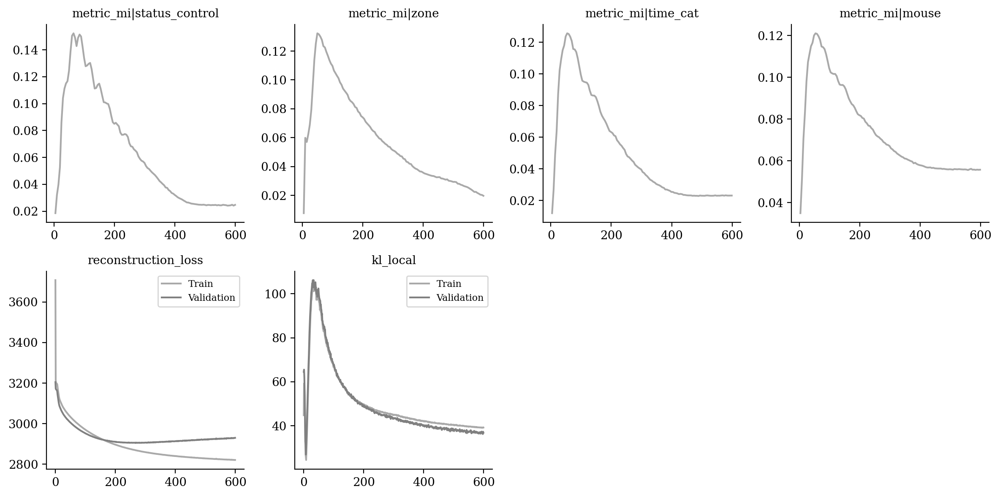

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

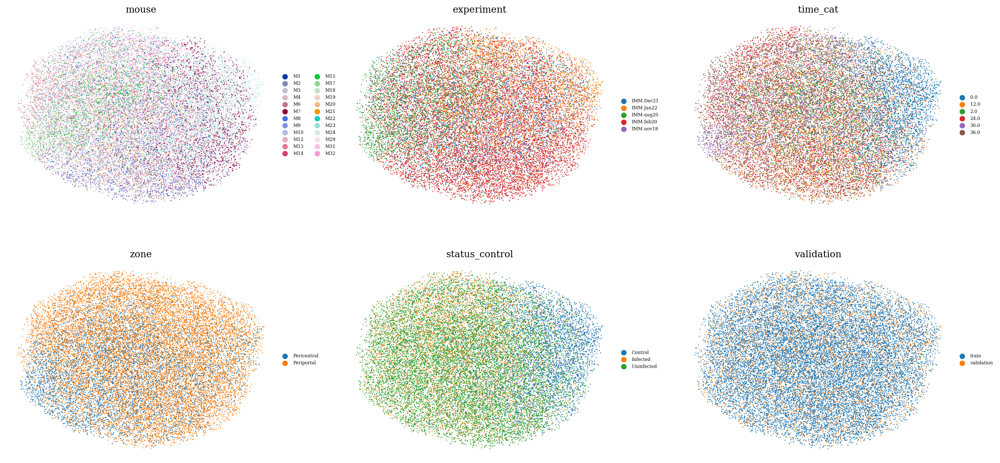

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

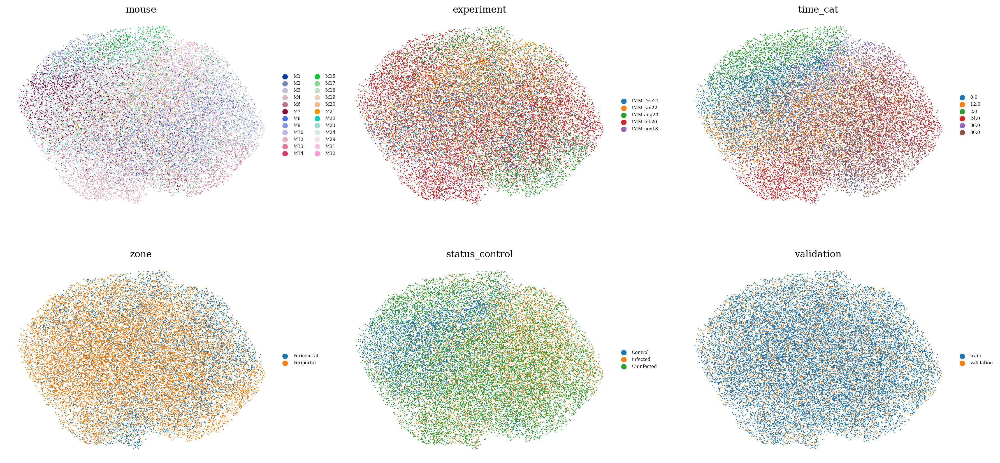

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

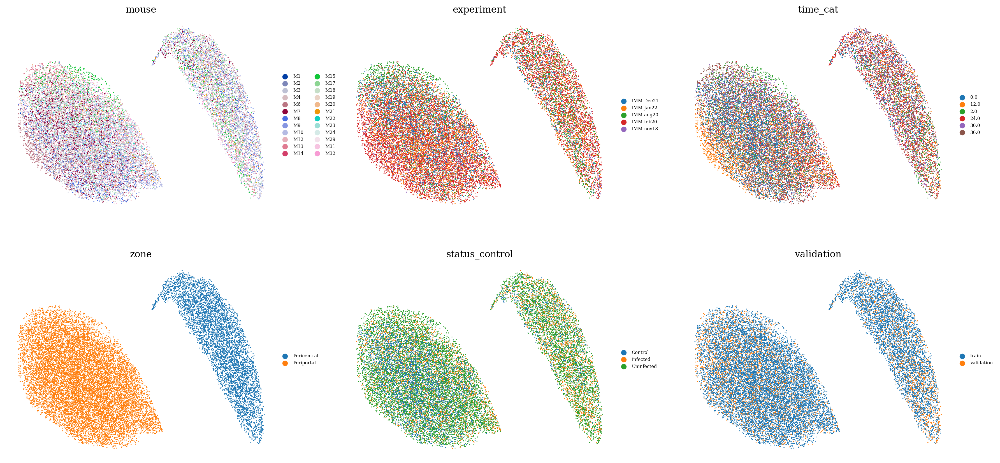

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

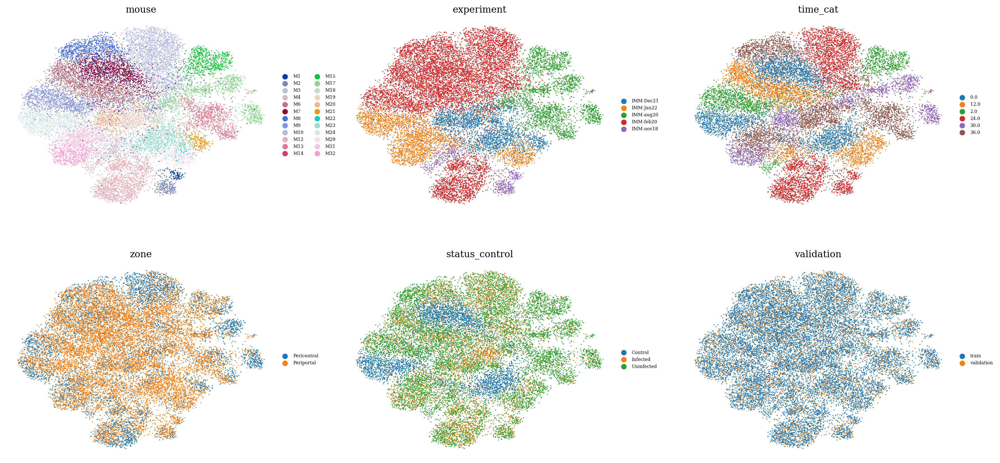

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

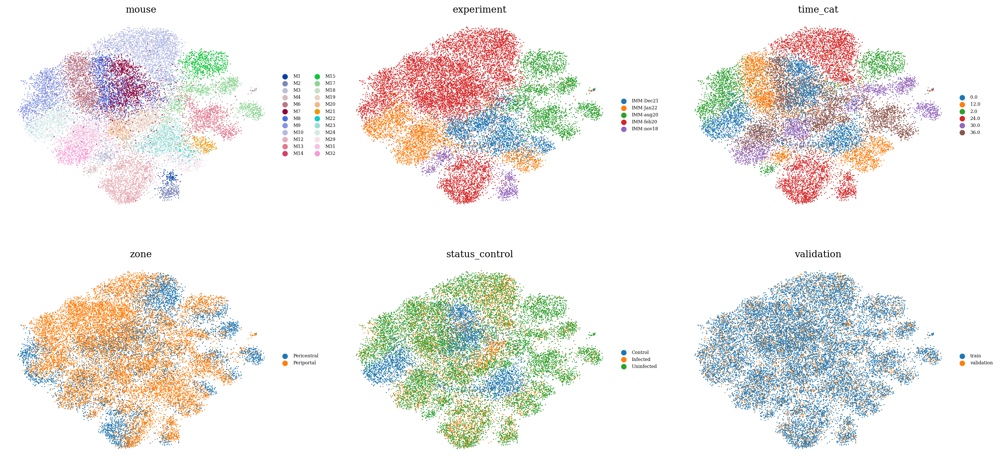

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

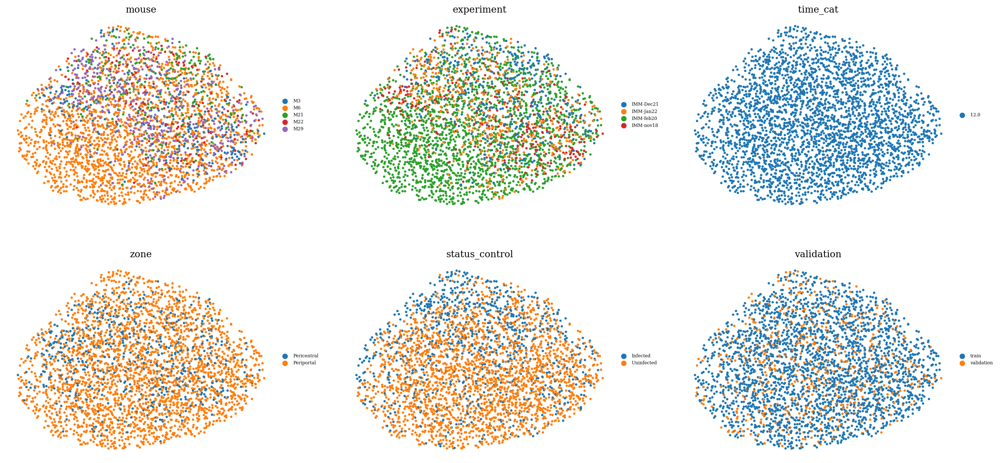

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )